In [26]:
import numpy as np
import matplotlib.pyplot as plt
from numpy import log
import ultranest
from ultranest.plot import cornerplot
from scipy.stats import poisson
from scipy.stats import norm
import pandas as pd
import healpy as hp
from healpy.newvisufunc import projview, newprojplot
import astropy.units as u
from numpy import pi, sin
from scipy.interpolate import interp1d
import scipy.stats as stats
import json
from matplotlib import colors as mcolors
from ultranest.utils import resample_equal
import ultranest.stepsampler
import os
import matplotlib.image as mpimg
import json
import corner
import os

In [ ]:
def dipole_sampling(NSIDE, N_bar, D, dipole_theta, dipole_phi):
    NPIX = hp.nside2npix(NSIDE)
    dipole_vec = hp.ang2vec(dipole_theta, dipole_phi) # (x, y, z) from (b, l)    
    pixels = np.vstack(hp.pix2vec(NSIDE, np.arange(NPIX)))
    
    dot_product = np.dot(dipole_vec, pixels)  
    angles = np.arccos(dot_product)
    dipole_signal = D*np.cos(angles)

    lambda_ = N_bar * (1 + dipole_signal)
    sample = np.random.poisson(lambda_)

    return sample, lambda_
    
def quadrupole_sampling(NSIDE, N_bar, Q, vector_1, vector_2):
    NPIX = hp.nside2npix(NSIDE)
    pixels = hp.pix2vec(NSIDE, np.arange(NPIX))
    b1, l1 = vector_1[0], vector_1[1]
    b2, l2 = vector_2[0], vector_2[1]
    
    # Constructing quadrupole tensor using the outer product of the 2 vectors
    v1 = hp.ang2vec(b1, l1)
    v2 = hp.ang2vec(b2, l2)
    Q_prime = np.outer(v1, v2)
    Q_star = 1/2 * (Q_prime + Q_prime.T)
    Q_hat = Q_star - (np.trace(Q_star)/3 * np.eye(3))

    # Quadrupole signal
    quad_signal = Q*np.einsum('ij,i...,j...', Q_hat, pixels, pixels)
    
    lambda_ = N_bar * (1 + quad_signal)
    sample = np.random.poisson(lambda_)
    return sample, lambda_

def dipole_plotting(m, dipole_theta=None, dipole_phi=None, title=None, unit=None, cmap='viridis'):
    projview(m, title=title, unit=unit,
    graticule=True, graticule_labels=True, projection_type="mollweide", cmap=cmap);

    newprojplot(theta=dipole_theta, phi=dipole_phi, marker="*", color="k", markersize=15);
    plt.tight_layout()
    return

def quadrupole_plotting(m, vector_1=None, vector_2=None, title=None, unit=None, cmap='viridis'):
    projview(m, title=title, unit=unit,
    graticule=True, graticule_labels=True, projection_type="mollweide", cmap=cmap);

    newprojplot(theta=vector_1[0], phi=vector_1[1], marker="*", color="k", markersize=15);
    newprojplot(theta=vector_2[0], phi=vector_2[1], marker="*", color="k", markersize=15);
    plt.tight_layout()
    return


def omega_to_theta(omega):
    '''Convert solid angle in steradins to theta in radians for
    a cone section of a sphere. Taken from the code used in Secrest (2021),
    namely in CatWISE_Dipole_Resulys.ipynb. '''
    return np.arccos(1 - omega / (2 * np.pi)) * u.rad

def compute_smooth_map(m: np.ndarray, weights=None, angle_scale=1):
        'Smooth the map using a moving average.'
        included_pixels = np.where(~np.isnan(m))[0]
        smoothed_map = np.full(m.shape, np.nan, dtype=float)
        nside = hp.get_nside(m)
        
        if type(weights) != np.ndarray:
            weights = np.ones_like(m).astype('float')

        smoothing_radius = omega_to_theta(angle_scale).value
        for p_index in included_pixels:
            vec = hp.pix2vec(nside, p_index)
            disc = hp.query_disc(nside, vec, smoothing_radius)
            smoothed_map[p_index] = np.nanmean(m[disc].astype(float) * weights[disc].astype(float))

        return smoothed_map

    
def sigma_to_prob2D(sigmas):
    return 1 - np.exp(-0.5 * np.array(sigmas) ** 2)

def compute_2D_contours(P_xy, contour_levels):
    '''
    Compute contour heights corresponding to sigma levels of probability
    density by creating a mapping (interpolation function) from the CDF
    (enclosed prob) to some arbitrary level of probability density.
    from here: https://stackoverflow.com/questions/37890550/python-plotting-percentile-contour-lines-of-a-probability-distribution

    :param P_xy: normalised 2D probability (not density)
    :param contour_levels: pass list of sigmas at which to draw the contours
    :return:
        1. vector of probabilities corresponding to heights at which to
        draw the contours (pass to e.g. plt.contour with levels= kwarg);
        2. uniformly spaced probability levels between 0 and max prob
        3. CDF at given P_level, of length 1000 (the hardcoded number of
            P_levels)
    '''
    P_levels = np.linspace(0, P_xy.max(), 1000)
    mask = (P_xy >= P_levels[:, None, None])
    P_integral = (mask * P_xy).sum(axis=(1,2))
    f = interp1d(P_integral, P_levels)
    t_contours = np.flip(f(sigma_to_prob2D(contour_levels)))
    return t_contours, P_levels, P_integral

def dipole_direction_distribution(result):
    equal_weighted_samples = resample_equal(
        np.array(result['samples']), np.array(result['weighted_samples']['weights']))
    nside=64
    npix = hp.nside2npix(nside)
    healpix_map = np.zeros(npix)
    l = equal_weighted_samples[:, 2]  
    b = equal_weighted_samples[:, 3]

    # Bin (l,b) into healpy pixels
    pixels = hp.ang2pix(nside, b,l, nest=False)
    for pix in pixels:
        healpix_map[pix] += 1
    
    #Smooth distribution
    smooth = 0.1
    healpix_map /= np.sum(healpix_map)
    smooth_map = hp.sphtfunc.smoothing(healpix_map, sigma=smooth)
    smooth_map[smooth_map < 0] = 0
    smooth_map /= np.sum(smooth_map)
    
    # Compute contours
    X, Y, proj_map = hp.projview(
    smooth_map, return_only_data=True, xsize=2000)
    P_xy = proj_map / np.sum(proj_map)
    contour_levels = [0.5, 1, 1.5]  
    t_contours, P_levels, P_integral = compute_2D_contours(P_xy, contour_levels)
    
    #plot
    hp.projview(smooth_map, cmap="Blues", graticule=True, graticule_labels=True)
    newprojplot(theta=dipole_theta, phi=dipole_phi, marker="*", color="r", markersize=15, zorder=5);

    plt.contour(X, Y, P_xy, levels=t_contours, colors=['C0','b','navy'])

    plt.tight_layout()
    
    return

    

# Dipole Model Priors and Likelihood

In [3]:
def dipole_prior_transform(cube):
    params = cube.copy()
    params[0] = cube[0]*2000 # 0 - 100
    params[1] = cube[1]/10 # 0 - 0.1
    params[2] = cube[2]*2*np.pi # 0 - 2pi
    
    c = cube[3] # 0 - 1, used to calculate theta below. 
    # Oliver uses 0 - 0.1, but this doesnt return theta between (0,pi), is it a typo or am i missing something else?
    params[3] = np.arccos(np.clip(1 - 2*c, -1, 1)) #Clipping to ensure we stay in the valid range
    
    return params
    
def dipole_likelihood(params):
    N_bar, D, l, b = params
    pixel_vec = np.vstack(hp.pix2vec(NSIDE, np.arange(NPIX))).T
    dipole_vec = hp.ang2vec(b, l) # dipole vector in cartesian
    angles = pixel_angles(pixel_vec, dipole_vec)
    
    lambda_i = N_bar * (1 + D*np.cos(angles))
    
    return np.sum(poisson.logpmf(m, mu=lambda_i))

# Monopole Model Priors and Likelihood

In [4]:
def mono_prior_transform(cube):
    params = cube.copy()
    params[0] = cube[0]*2000 
    
    return params
    
def mono_likelihood(params):
    N_bar = params
    
    lambda_i = N_bar
    
    return np.sum(poisson.logpmf(m, mu=lambda_i))

# Quadrupole Model Priors and Likelihood

In [5]:
def quad_prior_transform(cube):
    
    params = cube.copy()
    params[0] = cube[0]*2000 # 0 - 2000 (Nbar)
    params[1] = cube[1]/5 # 0 - 0.2 (Q)
    params[2] = cube[2]*2*np.pi # 0 - 2pi (l1)
    
    c = cube[3] # 0 - 1, used to calculate theta below. 
    params[3] = np.arccos(np.clip(1 - 2*c, -1, 1)) #(b1)
    
    params[4] = cube[4]*2*np.pi # 0 - 2pi (l2)
    params[5] = np.arccos(np.clip(1 - 2*c, -1, 1)) #(b2)
    
    return params
    
def quad_likelihood(params):
    N_bar, Q, l1, b1, l2, b2 = params
    
    pixels = hp.pix2vec(NSIDE, np.arange(NPIX))
    
    a = hp.ang2vec(b1, l1)
    b = hp.ang2vec(b2, l2)
    
    Q_prime = np.outer(a, b)
    Q_star = 1/2 * (Q_prime + Q_prime.T)
    Q_hat = Q_star - np.trace(Q_star)/3

    f = Q*np.einsum('ij,i...,j...', Q_hat, pixels, pixels)
    
    lambda_i = N_bar * (1 + f)
    
    return np.sum(poisson.logpmf(m, mu=lambda_i))

### Generate Data

In [6]:
NSIDE=64
NPIX = hp.nside2npix(NSIDE)
N_bar_true = 100
D_true = 0.007 # dipole amplitude, using value from paper

#  dipole vector
dipole_theta = np.pi/4
dipole_phi = -np.pi/2
# x_dip, y_dip, z_dip = hp.ang2vec(dipole_theta, dipole_phi) 

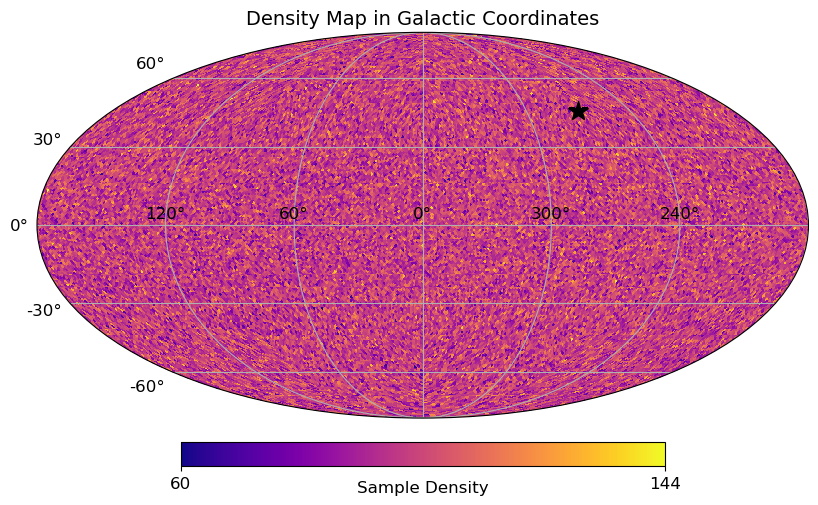

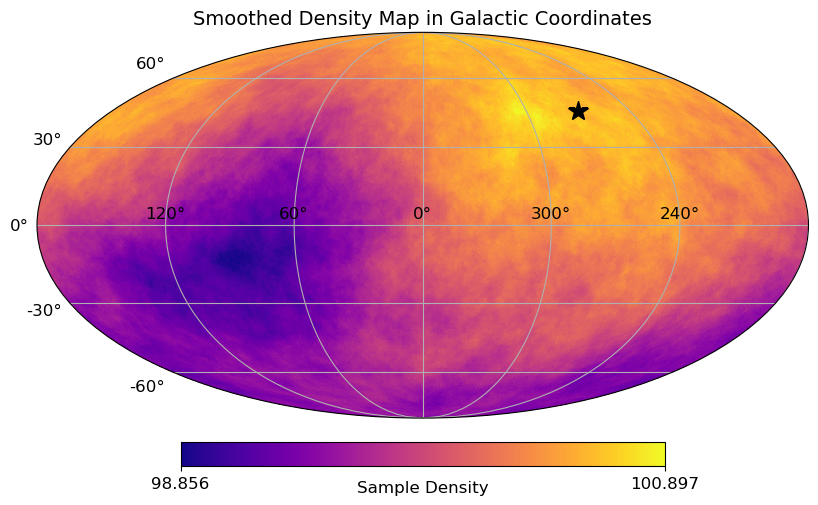

In [25]:
np.random.seed(4)
m, lambda_true_array = dipole_sampling(NSIDE=64,  N_bar=100, D=0.007, dipole_theta=np.pi/4, dipole_phi=-np.pi/2)

#Unsmoothed
dipole_plotting(m, dipole_theta, dipole_phi,
         title='Density Map in Galactic Coordinates', unit="Sample Density",
        cmap='plasma')

smoothed_map = compute_smooth_map(m, weights=None, angle_scale=1)

dipole_plotting(smoothed_map, dipole_theta, dipole_phi,
         title='Smoothed Density Map in Galactic Coordinates', unit="Sample Density",
        cmap='plasma')

(3, 2)


### Run both models and compare:

In [23]:
quad_param_names = [r'$\bar N$', 'Q', r'$\ell_1$', 'b1', r'$\ell_2$', 'b2' ]
dipole_param_names = [r'$\bar N$', 'D', r'$\ell$', 'b']
mono_param_names = [r'$\bar N$']

In [24]:
dipole_sampler = ultranest.ReactiveNestedSampler(dipole_param_names, dipole_likelihood, dipole_prior_transform)
dipole_result = dipole_sampler.run()
dipole_sampler.print_results()

[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-183136.07 [-183136.2054..-183136.2051]*| it/evals=9368/20400 eff=46.8400% N=400      
[ultranest] Likelihood function evaluations: 20402
[ultranest]   logZ = -1.832e+05 +- 0.1368
[ultranest] Effective samples strategy satisfied (ESS = 2126.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.21 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.

logZ = -183154.979 +- 0.314
  single instance: logZ = -183154.979 +- 0.206
  bootstrapped   : logZ = -183155.004 +- 0.314
  tail           : logZ = +- 0.010
insert order U test : converged: True correlation: inf iterations

    $\bar N$            : 99.730│ ▁ ▁ ▁▁▁▁▁▁▁▂▃▃▄▄▆▇▆▇▆▆▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁ │100.124    99.934 +- 0.046
    D                   : 0.00460│ ▁▁ ▁▁▁▁▁▁▁▁▃▃▄▅▅▆▇▇▇▇▇▅▅▃▃▂▂▁▁▁▁▁ ▁▁▁ │0.01118    0.0079

In [25]:
mono_sampler = ultranest.ReactiveNestedSampler(mono_param_names, mono_likelihood, mono_prior_transform)
mono_result = mono_sampler.run()
mono_sampler.print_results()

[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-183189.22 [-183189.2161..-183189.2161]*| it/evals=5265/5847 eff=96.6587% N=400 00   
[ultranest] Likelihood function evaluations: 5853
[ultranest]   logZ = -1.832e+05 +- 0.1447
[ultranest] Effective samples strategy satisfied (ESS = 1251.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.14 tail:0.03 total:0.15 required:<0.50
[ultranest] done iterating.

logZ = -183198.994 +- 0.309
  single instance: logZ = -183198.994 +- 0.152
  bootstrapped   : logZ = -183199.025 +- 0.307
  tail           : logZ = +- 0.033
insert order U test : converged: True correlation: inf iterations

    $\bar N$            : 99.757│ ▁ ▁▁▁▁▁▁▂▂▄▄▄▆▇▇▇▇▇▆▅▅▆▃▂▂▂▁▁▁▁▁▁▁▁ ▁ │100.130    99.932 +- 0.045



In [1]:
quad_sampler = ultranest.ReactiveNestedSampler(quad_param_names, quad_likelihood,
                                               quad_prior_transform, vectorized=True)
quad_result = quad_sampler.run()
quad_sampler.print_results()

NameError: name 'ultranest' is not defined

In [ ]:
cornerplot(dipole_result, truths=[N_bar_true, D_true, -dipole_phi+np.pi, dipole_theta], truth_color='r')
plt.show()

In [ ]:
cornerplot(mono_result)
plt.axvline(N_bar_true, c='r')
plt.show()

In [ ]:
cornerplot(quad_result, truths=[N_bar_true, None, -dipole_phi+np.pi, dipole_theta, None, None], truth_color='r')
plt.show()

# Calculate the Bayes Factor

In [15]:
ln_K = (dipole_result['logz'] - mono_result['logz']) # The ln of the Bayes Factor
print(ln_K)
ln_J = (dipole_result['logz'] - quad_result['logz']) 
print(ln_J)
ln_I = (mono_result['logz'] - quad_result['logz'])
print(ln_I)

12.571758893718652
16.339039438273176
3.7672805445545237


# Loop over different densities and resolutions and compute Bayes factors

### Need to also extract the inferred dipole amplitude to see when it is over/under estimated and how this varies with N_bar and NSIDE

In [53]:
# np.random.seed(42)
dipole_param_names = [r'$\bar N$', 'D', r'$\ell$', 'b']
mono_param_names = [r'$\bar N$']
Bayes_factors = {}
dipole_amplitudes = {}

resolutions = [8,16,24,32,40,48,56,64]
N_bars = [0.1,0.5,1,5,10,20,40,100,200]

# resolutions = [8,16,32,64]
# N_bars = [0.5,1,5,10,30,60,100]

for N_bar_true in N_bars:
    for NSIDE in resolutions:
        
        #generate data
        NPIX = hp.nside2npix(NSIDE)
        m, lambda_true_array = poisson_sampling(NSIDE=NSIDE,  N_bar=N_bar_true, D=0.007,
                                                dipole_theta=np.pi/4, dipole_phi=-np.pi/2)
        print('done generating data')
        #Plot skymap and smooth skymap
        plotting(m, dipole_theta, dipole_phi,
         title='Density Map in Galactic Coordinates', unit="Sample Density",
        cmap='plasma')
        
        plt.savefig('../Figures/Loop/Skymaps/nside_{:s}_nbar_{:s}_skymap.png'.format(str(NSIDE),str(N_bar_true)), dpi=300)
        plt.close()
        
        smoothed_map = compute_smooth_map(m, weights=None, angle_scale=1)

        plotting(smoothed_map, dipole_theta, dipole_phi,
         title='Smoothed Density Map in Galactic Coordinates', unit="Sample Density",
        cmap='plasma')
        
        plt.savefig('../Figures/Loop/Smoothed_skymaps/nside_{:s}_nbar_{:s}_smoothed_skymap.png'.format(str(NSIDE),str(N_bar_true)), dpi=300)
        plt.close()    
        print('done plotting data')
        
        # Run the dipole and monopole model, creating the cornerplots
        dipole_sampler = ultranest.ReactiveNestedSampler(dipole_param_names, dipole_likelihood, dipole_prior_transform)
        dipole_result = dipole_sampler.run()
        #min_num_live_points = 400
        
        cornerplot(dipole_result, truths=[N_bar_true, 0.007, --np.pi/2+np.pi, np.pi/4], truth_color='r')
        plt.savefig('../Figures/Loop/Cornerplots/Dipole/nside_{:s}_nbar_{:s}_CP_D.png'.format(str(NSIDE),str(N_bar_true)), dpi=300)
        plt.close()
        
        mono_sampler = ultranest.ReactiveNestedSampler(mono_param_names, mono_likelihood, mono_prior_transform)
        mono_result = mono_sampler.run()
            
        cornerplot(mono_result)
        plt.axvline(N_bar_true, c='r')
        plt.tight_layout()
        plt.savefig('../Figures/Loop/Cornerplots/Monopole/nside_{:s}_nbar_{:s}_CP_M.png'.format(str(NSIDE),str(N_bar_true)), dpi=300)
        plt.close()
        print('done running models')
        # Plot the posterior dipole direction distribution
        dipole_direction_distribution(dipole_result)
        plt.savefig('../Figures/Loop/Dipole_distributions/nside_{:s}_nbar_{:s}_dipole.png'.format(str(NSIDE),str(N_bar_true)),dpi=300)
        plt.close()
        print('done plotting dipole direction')
        
        # bayes factor to compare model
        ln_K = (dipole_result['logz'] - mono_result['logz'])
        
        if N_bar_true not in Bayes_factors:
            Bayes_factors[N_bar_true] = []
        Bayes_factors[N_bar_true].append(ln_K)
        
        # Also want to see how the dipole amplitude estimation varies with the Bayes factor
        dip_amp = dipole_result['posterior']['mean'][1]
        if N_bar_true not in dipole_amplitudes:
            dipole_amplitudes[N_bar_true] = []
        dipole_amplitudes[N_bar_true].append(dip_amp)
        print('done saving data')


done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+02  .16 [-288.2864..-288.2862]*| it/evals=6360/12274 eff=53.5624% N=400       00  0 
[ultranest] Likelihood function evaluations: 12305
[ultranest]   logZ = -299.6 +- 0.1248
[ultranest] Effective samples strategy satisfied (ESS = 1350.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+02  .56 [-288.5635..-288.5635]*| it/evals=5800/6364 eff=97.2502% N=400     0   00  
[ultranest] Likelihood function evaluations: 6389
[ultranest]   logZ = -299.8 +- 0.126
[ultranest] Effective samples strategy satisfied (ESS = 1291.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+03  015.62 [-1015.9017..-1015.9015]*| it/evals=7240/14744 eff=50.4741% N=400    0  0  
[ultranest] Likelihood function evaluations: 14849
[ultranest]   logZ = -1029 +- 0.153
[ultranest] Effective samples strategy satisfied (ESS = 1937.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+03  018.02 [-1018.0254..-1018.0254]*| it/evals=6000/6560 eff=97.4026% N=400 0  00  0 
[ultranest] Likelihood function evaluations: 6590
[ultranest]   logZ = -1030 +- 0.1162
[ultranest] Effective samples strategy satisfied (ESS = 1258.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  294.75 [-2294.8132..-2294.8131]*| it/evals=6840/13874 eff=50.7644% N=400    0       
[ultranest] Likelihood function evaluations: 13890
[ultranest]   logZ = -2307 +- 0.1233
[ultranest] Effective samples strategy satisfied (ESS = 1420.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  294.90 [-2294.9013..-2294.9013]*| it/evals=6030/6602 eff=97.2267% N=400 00  0   0  0 
[ultranest] Likelihood function evaluations: 6602
[ultranest]   logZ = -2307 +- 0.1088
[ultranest] Effective samples strategy satisfied (ESS = 1222.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+03  159.41 [-4159.5372..-4159.5369]*| it/evals=7440/15748 eff=48.4754% N=400    0   0    
[ultranest] Likelihood function evaluations: 15781
[ultranest]   logZ = -4173 +- 0.1388
[ultranest] Effective samples strategy satisfied (ESS = 1815.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+03  160.95 [-4160.9524..-4160.9524]*| it/evals=6300/6886 eff=97.1323% N=400 0  00   0  0  
[ultranest] Likelihood function evaluations: 6894
[ultranest]   logZ = -4173 +- 0.18
[ultranest] Effective samples strategy satisfied (ESS = 1230.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.18, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.18 tail:0.04 total:0.18 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+03  232.02 [-6232.1975..-6232.1972]*| it/evals=8050/17571 eff=46.8814% N=400    0   0   0 
[ultranest] Likelihood function evaluations: 17580
[ultranest]   logZ = -6248 +- 0.1677
[ultranest] Effective samples strategy satisfied (ESS = 2228.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.17, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.17 tail:0.01 total:0.17 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+03  235.24 [-6235.2451..-6235.2451]*| it/evals=6440/7029 eff=97.1489% N=400 0   0   0     
[ultranest] Likelihood function evaluations: 7052
[ultranest]   logZ = -6248 +- 0.1257
[ultranest] Effective samples strategy satisfied (ESS = 1265.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  160.37 [-9160.5159..-9160.5158]*| it/evals=7813/16878 eff=47.4147% N=400    0   0   0  
[ultranest] Likelihood function evaluations: 16889
[ultranest]   logZ = -9175 +- 0.1282
[ultranest] Effective samples strategy satisfied (ESS = 1936.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  162.33 [-9162.3273..-9162.3273]*| it/evals=6480/7047 eff=97.4876% N=400 0   0    0  0 
[ultranest] Likelihood function evaluations: 7071
[ultranest]   logZ = -9175 +- 0.1351
[ultranest] Effective samples strategy satisfied (ESS = 1240.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.03 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -12836.18 [-12836.3347..-12836.3346]*| it/evals=7863/18021 eff=44.6229% N=400    0  0  
[ultranest] Likelihood function evaluations: 18031
[ultranest]   logZ = -1.285e+04 +- 0.114
[ultranest] Effective samples strategy satisfied (ESS = 1831.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -12837.74 [-12837.7441..-12837.7441]*| it/evals=6600/7184 eff=97.2877% N=400 0   0   0 
[ultranest] Likelihood function evaluations: 7204
[ultranest]   logZ = -1.285e+04 +- 0.1113
[ultranest] Effective samples strategy satisfied (ESS = 1238.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.11 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -16808.03 [-16808.1087..-16808.1086]*| it/evals=7650/15143 eff=51.8890% N=400          
[ultranest] Likelihood function evaluations: 15146
[ultranest]   logZ = -1.682e+04 +- 0.1404
[ultranest] Effective samples strategy satisfied (ESS = 1599.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -16808.20 [-16808.2001..-16808.2001]*| it/evals=6640/7217 eff=97.4035% N=400 00  0     
[ultranest] Likelihood function evaluations: 7233
[ultranest]   logZ = -1.682e+04 +- 0.1345
[ultranest] Effective samples strategy satisfied (ESS = 1259.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.03 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+02  .38 [-691.4086..-691.4085]*| it/evals=6080/11520 eff=54.6763% N=400    0   00  
[ultranest] Likelihood function evaluations: 11617
[ultranest]   logZ = -702.1 +- 0.1294
[ultranest] Effective samples strategy satisfied (ESS = 1346.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+02  .42 [-691.4172..-691.4172]*| it/evals=5520/6050 eff=97.6991% N=400 0   0   00 0 
[ultranest] Likelihood function evaluations: 6083
[ultranest]   logZ = -702 +- 0.1132
[ultranest] Effective samples strategy satisfied (ESS = 1266.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  768.24 [-2768.3851..-2768.3848]*| it/evals=6880/12805 eff=55.4615% N=400    0  0  
[ultranest] Likelihood function evaluations: 12823
[ultranest]   logZ = -2781 +- 0.1618
[ultranest] Effective samples strategy satisfied (ESS = 1734.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.16 tail:0.01 total:0.16 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  769.62 [-2769.6204..-2769.6203]*| it/evals=5760/6299 eff=97.6437% N=400  0  0  0  
[ultranest] Likelihood function evaluations: 6317
[ultranest]   logZ = -2781 +- 0.1509
[ultranest] Effective samples strategy satisfied (ESS = 1257.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.15 tail:0.03 total:0.15 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+03  434.26 [-6434.4275..-6434.4275]*| it/evals=7400/14926 eff=50.9431% N=400    0   0  0 
[ultranest] Likelihood function evaluations: 14976
[ultranest]   logZ = -6448 +- 0.1448
[ultranest] Effective samples strategy satisfied (ESS = 1871.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+03  435.97 [-6435.9667..-6435.9667]*| it/evals=6040/6609 eff=97.2781% N=400 0   0   00 0 
[ultranest] Likelihood function evaluations: 6628
[ultranest]   logZ = -6448 +- 0.1085
[ultranest] Effective samples strategy satisfied (ESS = 1251.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.03 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -11429.63 [-11429.7858..-11429.7857]*| it/evals=7380/14724 eff=51.5219% N=400    0    
[ultranest] Likelihood function evaluations: 14738
[ultranest]   logZ = -1.144e+04 +- 0.1447
[ultranest] Effective samples strategy satisfied (ESS = 1928.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -11431.42 [-11431.4253..-11431.4253]*| it/evals=6080/6672 eff=96.9388% N=400 0   0    
[ultranest] Likelihood function evaluations: 6683
[ultranest]   logZ = -1.144e+04 +- 0.1303
[ultranest] Effective samples strategy satisfied (ESS = 1234.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.13 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -17872.02 [-17872.1313..-17872.1311]*| it/evals=7388/16627 eff=45.5291% N=400    0  0 
[ultranest] Likelihood function evaluations: 16655
[ultranest]   logZ = -1.789e+04 +- 0.1274
[ultranest] Effective samples strategy satisfied (ESS = 1665.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -17872.49 [-17872.4954..-17872.4954]*| it/evals=6120/6678 eff=97.4833% N=400 0   0    
[ultranest] Likelihood function evaluations: 6718
[ultranest]   logZ = -1.788e+04 +- 0.1596
[ultranest] Effective samples strategy satisfied (ESS = 1239.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.16 tail:0.04 total:0.16 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25693.67 [-25693.8273..-25693.8270]*| it/evals=7600/15867 eff=49.1369% N=400    0  0  
[ultranest] Likelihood function evaluations: 15884
[ultranest]   logZ = -2.571e+04 +- 0.1246
[ultranest] Effective samples strategy satisfied (ESS = 1789.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25694.98 [-25694.9854..-25694.9854]*| it/evals=6160/6742 eff=97.1302% N=400 0      0  
[ultranest] Likelihood function evaluations: 6748
[ultranest]   logZ = -2.571e+04 +- 0.1353
[ultranest] Effective samples strategy satisfied (ESS = 1256.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.04 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -34763.22 [-34763.3827..-34763.3825]*| it/evals=7800/16862 eff=47.3818% N=400    0     
[ultranest] Likelihood function evaluations: 16878
[ultranest]   logZ = -3.478e+04 +- 0.1122
[ultranest] Effective samples strategy satisfied (ESS = 1738.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -34764.47 [-34764.4673..-34764.4673]*| it/evals=6200/6783 eff=97.1330% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 6799
[ultranest]   logZ = -3.478e+04 +- 0.1376
[ultranest] Effective samples strategy satisfied (ESS = 1260.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.04 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -45586.08 [-45586.2140..-45586.2134]*| it/evals=7747/17020 eff=46.6125% N=400 0        
[ultranest] Likelihood function evaluations: 17031
[ultranest]   logZ = -4.56e+04 +- 0.1487
[ultranest] Effective samples strategy satisfied (ESS = 1633.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -45586.75 [-45586.7498..-45586.7498]*| it/evals=6240/6797 eff=97.5457% N=400 0   0     
[ultranest] Likelihood function evaluations: 6825
[ultranest]   logZ = -4.56e+04 +- 0.1263
[ultranest] Effective samples strategy satisfied (ESS = 1243.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.13 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+03  1.73 [-991.8807..-991.8806]*| it/evals=6280/12297 eff=52.7864% N=400   0    0 0 
[ultranest] Likelihood function evaluations: 12319
[ultranest]   logZ = -1003 +- 0.1212
[ultranest] Effective samples strategy satisfied (ESS = 1610.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+03  2.68 [-992.6837..-992.6837]*| it/evals=5360/5923 eff=97.0487% N=400    0    00  
[ultranest] Likelihood function evaluations: 5941
[ultranest]   logZ = -1003 +- 0.1136
[ultranest] Effective samples strategy satisfied (ESS = 1257.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+03  989.75 [-3989.9029..-3989.9021]*| it/evals=6840/15953 eff=43.9787% N=400    0  0  
[ultranest] Likelihood function evaluations: 16032
[ultranest]   logZ = -4002 +- 0.1184
[ultranest] Effective samples strategy satisfied (ESS = 1796.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+03  991.25 [-3991.2520..-3991.2520]*| it/evals=5640/6197 eff=97.2917% N=400 0   0  0  
[ultranest] Likelihood function evaluations: 6203
[ultranest]   logZ = -4002 +- 0.1061
[ultranest] Effective samples strategy satisfied (ESS = 1244.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  011.30 [-9011.4307..-9011.4305]*| it/evals=6880/14466 eff=48.9123% N=400    0      
[ultranest] Likelihood function evaluations: 14505
[ultranest]   logZ = -9024 +- 0.106
[ultranest] Effective samples strategy satisfied (ESS = 1715.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  012.23 [-9012.2308..-9012.2308]*| it/evals=5720/6283 eff=97.2293% N=400 0   0    0 0 
[ultranest] Likelihood function evaluations: 6295
[ultranest]   logZ = -9023 +- 0.1261
[ultranest] Effective samples strategy satisfied (ESS = 1245.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -15932.20 [-15932.3519..-15932.3517]*| it/evals=7400/18125 eff=41.7489% N=400    0    
[ultranest] Likelihood function evaluations: 18125
[ultranest]   logZ = -1.595e+04 +- 0.1377
[ultranest] Effective samples strategy satisfied (ESS = 1827.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -15933.76 [-15933.7571..-15933.7571]*| it/evals=5880/6456 eff=97.0938% N=400 0   0    
[ultranest] Likelihood function evaluations: 6463
[ultranest]   logZ = -1.595e+04 +- 0.1166
[ultranest] Effective samples strategy satisfied (ESS = 1215.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25115.28 [-25115.4462..-25115.4461]*| it/evals=7589/19571 eff=39.5858% N=400 0  0  0  
[ultranest] Likelihood function evaluations: 19579
[ultranest]   logZ = -2.513e+04 +- 0.1269
[ultranest] Effective samples strategy satisfied (ESS = 1890.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25117.01 [-25117.0088..-25117.0088]*| it/evals=6030/6607 eff=97.1484% N=400     0    
[ultranest] Likelihood function evaluations: 6614
[ultranest]   logZ = -2.513e+04 +- 0.1157
[ultranest] Effective samples strategy satisfied (ESS = 1229.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -36049.41 [-36049.5629..-36049.5626]*| it/evals=8310/19915 eff=42.5826% N=400    0  0  
[ultranest] Likelihood function evaluations: 19924
[ultranest]   logZ = -3.607e+04 +- 0.1632
[ultranest] Effective samples strategy satisfied (ESS = 2330.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.16 tail:0.01 total:0.16 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -36053.94 [-36053.9373..-36053.9373]*| it/evals=6030/6614 eff=97.0389% N=400 0   0  0  
[ultranest] Likelihood function evaluations: 6616
[ultranest]   logZ = -3.607e+04 +- 0.1297
[ultranest] Effective samples strategy satisfied (ESS = 1260.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.13 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49245.56 [-49245.6895..-49245.6894]*| it/evals=7696/15819 eff=49.9124% N=400    0  0  
[ultranest] Likelihood function evaluations: 15819
[ultranest]   logZ = -4.926e+04 +- 0.1101
[ultranest] Effective samples strategy satisfied (ESS = 1703.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49246.33 [-49246.3282..-49246.3282]*| it/evals=6120/6701 eff=97.1274% N=400 0   00    
[ultranest] Likelihood function evaluations: 6707
[ultranest]   logZ = -4.926e+04 +- 0.1176
[ultranest] Effective samples strategy satisfied (ESS = 1274.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -64076.21 [-64076.3574..-64076.3574]*| it/evals=7783/17071 eff=46.6859% N=400    0     
[ultranest] Likelihood function evaluations: 17083
[ultranest]   logZ = -6.409e+04 +- 0.1046
[ultranest] Effective samples strategy satisfied (ESS = 1660.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.10 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -64077.00 [-64076.9995..-64076.9995]*| it/evals=6120/6681 eff=97.4367% N=400 0   0   0 
[ultranest] Likelihood function evaluations: 6709
[ultranest]   logZ = -6.409e+04 +- 0.1381
[ultranest] Effective samples strategy satisfied (ESS = 1243.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.03 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  702.92 [-1703.0492..-1703.0491]*| it/evals=6000/14133 eff=43.6904% N=400    0 0 
[ultranest] Likelihood function evaluations: 14171
[ultranest]   logZ = -1713 +- 0.1013
[ultranest] Effective samples strategy satisfied (ESS = 1645.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.10 tail:0.01 total:0.10 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  703.47 [-1703.4694..-1703.4694]*| it/evals=4960/5518 eff=96.9129% N=400 0     0 
[ultranest] Likelihood function evaluations: 5548
[ultranest]   logZ = -1713 +- 0.1024
[ultranest] Effective samples strategy satisfied (ESS = 1266.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.10 tail:0.03 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+03  739.31 [-6739.4547..-6739.4540]*| it/evals=6560/15610 eff=43.1295% N=400    00    
[ultranest] Likelihood function evaluations: 15614
[ultranest]   logZ = -6751 +- 0.1349
[ultranest] Effective samples strategy satisfied (ESS = 1799.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+03  740.72 [-6740.7186..-6740.7186]*| it/evals=5400/5949 eff=97.3148% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 5968
[ultranest]   logZ = -6751 +- 0.1176
[ultranest] Effective samples strategy satisfied (ESS = 1243.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.44+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -15232.50 [-15232.6801..-15232.6801]*| it/evals=7280/16043 eff=46.5384% N=400    0 0 
[ultranest] Likelihood function evaluations: 16096
[ultranest]   logZ = -1.525e+04 +- 0.1139
[ultranest] Effective samples strategy satisfied (ESS = 1980.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -15234.61 [-15234.6111..-15234.6111]*| it/evals=5360/5895 eff=97.5432% N=400 0      
[ultranest] Likelihood function evaluations: 5913
[ultranest]   logZ = -1.524e+04 +- 0.1112
[ultranest] Effective samples strategy satisfied (ESS = 1249.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -27080.82 [-27080.9718..-27080.9717]*| it/evals=7240/16402 eff=45.2443% N=400    0    
[ultranest] Likelihood function evaluations: 16405
[ultranest]   logZ = -2.709e+04 +- 0.1405
[ultranest] Effective samples strategy satisfied (ESS = 1816.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -27082.30 [-27082.3016..-27082.3016]*| it/evals=5560/6120 eff=97.2028% N=400 0   0    
[ultranest] Likelihood function evaluations: 6121
[ultranest]   logZ = -2.709e+04 +- 0.1098
[ultranest] Effective samples strategy satisfied (ESS = 1252.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -42489.63 [-42489.7952..-42489.7952]*| it/evals=7427/17487 eff=43.4658% N=400    0     
[ultranest] Likelihood function evaluations: 17502
[ultranest]   logZ = -4.25e+04 +- 0.1305
[ultranest] Effective samples strategy satisfied (ESS = 1774.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -42490.86 [-42490.8628..-42490.8628]*| it/evals=5520/6091 eff=96.9953% N=400 0  00    
[ultranest] Likelihood function evaluations: 6115
[ultranest]   logZ = -4.25e+04 +- 0.1475
[ultranest] Effective samples strategy satisfied (ESS = 1254.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.15 tail:0.04 total:0.15 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -60826.23 [-60826.3527..-60826.3524]*| it/evals=7502/16913 eff=45.4309% N=400    0  0  
[ultranest] Likelihood function evaluations: 16914
[ultranest]   logZ = -6.084e+04 +- 0.141
[ultranest] Effective samples strategy satisfied (ESS = 1669.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -60826.89 [-60826.8944..-60826.8944]*| it/evals=5680/6242 eff=97.2270% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 6256
[ultranest]   logZ = -6.084e+04 +- 0.1497
[ultranest] Effective samples strategy satisfied (ESS = 1276.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.15 tail:0.04 total:0.15 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -82787.27 [-82787.4229..-82787.4229]*| it/evals=8331/17318 eff=49.2434% N=400    0  0  
[ultranest] Likelihood function evaluations: 17327
[ultranest]   logZ = -8.28e+04 +- 0.1473
[ultranest] Effective samples strategy satisfied (ESS = 2311.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -82791.21 [-82791.2153..-82791.2153]*| it/evals=5680/6265 eff=96.8457% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 6287
[ultranest]   logZ = -8.28e+04 +- 0.1481
[ultranest] Effective samples strategy satisfied (ESS = 1236.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.15 tail:0.04 total:0.15 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-108432.41 [-108432.5704..-108432.5702]*| it/evals=8331/18065 eff=47.1611% N=400      
[ultranest] Likelihood function evaluations: 18077
[ultranest]   logZ = -1.084e+05 +- 0.1511
[ultranest] Effective samples strategy satisfied (ESS = 2251.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-108436.33 [-108436.3335..-108436.3335]*| it/evals=5670/6230 eff=97.2556% N=400 0     
[ultranest] Likelihood function evaluations: 6231
[ultranest]   logZ = -1.084e+05 +- 0.121
[ultranest] Effective samples strategy satisfied (ESS = 1216.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  974.00 [-1974.1039..-1974.1037]*| it/evals=6000/13706 eff=45.0924% N=400    0 0 
[ultranest] Likelihood function evaluations: 13737
[ultranest]   logZ = -1985 +- 0.1199
[ultranest] Effective samples strategy satisfied (ESS = 1614.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  974.31 [-1974.3078..-1974.3078]*| it/evals=4720/5263 eff=97.0594% N=400 0     0 
[ultranest] Likelihood function evaluations: 5293
[ultranest]   logZ = -1983 +- 0.1219
[ultranest] Effective samples strategy satisfied (ESS = 1252.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.12 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+03  897.98 [-7898.1450..-7898.1446]*| it/evals=7000/15376 eff=46.7415% N=400    0  0  
[ultranest] Likelihood function evaluations: 15403
[ultranest]   logZ = -7911 +- 0.1214
[ultranest] Effective samples strategy satisfied (ESS = 2254.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.12 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+03  901.17 [-7901.1721..-7901.1721]*| it/evals=5160/5706 eff=97.2484% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 5708
[ultranest]   logZ = -7911 +- 0.09138
[ultranest] Effective samples strategy satisfied (ESS = 1264.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.09 tail:0.03 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -17678.06 [-17678.2042..-17678.2038]*| it/evals=7650/18218 eff=42.9341% N=400       
[ultranest] Likelihood function evaluations: 18268
[ultranest]   logZ = -1.769e+04 +- 0.1494
[ultranest] Effective samples strategy satisfied (ESS = 2197.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -17682.63 [-17682.6323..-17682.6322]*| it/evals=5240/5801 eff=97.0191% N=400 0      
[ultranest] Likelihood function evaluations: 5827
[ultranest]   logZ = -1.769e+04 +- 0.09308
[ultranest] Effective samples strategy satisfied (ESS = 1277.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.10 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.09 tail:0.03 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -31402.80 [-31402.9703..-31402.9703]*| it/evals=7830/18275 eff=43.8042% N=400    0    
[ultranest] Likelihood function evaluations: 18279
[ultranest]   logZ = -3.142e+04 +- 0.1371
[ultranest] Effective samples strategy satisfied (ESS = 2310.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -31407.14 [-31407.1385..-31407.1385]*| it/evals=5320/5875 eff=97.1689% N=400 0   0    
[ultranest] Likelihood function evaluations: 5875
[ultranest]   logZ = -3.142e+04 +- 0.1229
[ultranest] Effective samples strategy satisfied (ESS = 1226.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49256.16 [-49256.3333..-49256.3331]*| it/evals=7574/17960 eff=43.1321% N=400    0  0 
[ultranest] Likelihood function evaluations: 17986
[ultranest]   logZ = -4.927e+04 +- 0.1211
[ultranest] Effective samples strategy satisfied (ESS = 1854.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49257.72 [-49257.7175..-49257.7175]*| it/evals=5490/6066 eff=96.8938% N=400 0   0    
[ultranest] Likelihood function evaluations: 6077
[ultranest]   logZ = -4.927e+04 +- 0.1061
[ultranest] Effective samples strategy satisfied (ESS = 1221.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.10 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+04  -70803.84 [-70803.9974..-70803.9973]*| it/evals=7749/18862 eff=41.9727% N=400    0  0  
[ultranest] Likelihood function evaluations: 18869
[ultranest]   logZ = -7.082e+04 +- 0.1358
[ultranest] Effective samples strategy satisfied (ESS = 1735.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+04  -70805.09 [-70805.0920..-70805.0919]*| it/evals=5520/6087 eff=97.0635% N=400 0   0    
[ultranest] Likelihood function evaluations: 6113
[ultranest]   logZ = -7.082e+04 +- 0.1381
[ultranest] Effective samples strategy satisfied (ESS = 1249.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.14 tail:0.04 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  -96661.89 [-96662.0584..-96662.0584]*| it/evals=8034/19057 eff=43.0616% N=400    0   0  
[ultranest] Likelihood function evaluations: 19060
[ultranest]   logZ = -9.668e+04 +- 0.1343
[ultranest] Effective samples strategy satisfied (ESS = 2106.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  -96664.51 [-96664.5093..-96664.5093]*| it/evals=5600/6191 eff=96.7018% N=400 0   00 0  
[ultranest] Likelihood function evaluations: 6211
[ultranest]   logZ = -9.668e+04 +- 0.08346
[ultranest] Effective samples strategy satisfied (ESS = 1256.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.09, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.08 tail:0.03 total:0.09 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-125922.39 [-125922.5544..-125922.5543]*| it/evals=8386/21613 eff=39.5324% N=400   0  
[ultranest] Likelihood function evaluations: 21618
[ultranest]   logZ = -1.259e+05 +- 0.1459
[ultranest] Effective samples strategy satisfied (ESS = 2367.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-125927.01 [-125927.0101..-125927.0101]*| it/evals=5800/6370 eff=97.1524% N=400 0     
[ultranest] Likelihood function evaluations: 6370
[ultranest]   logZ = -1.259e+05 +- 0.1102
[ultranest] Effective samples strategy satisfied (ESS = 1266.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  255.33 [-2255.4543..-2255.4543]*| it/evals=6000/12847 eff=48.2044% N=400      0 
[ultranest] Likelihood function evaluations: 12873
[ultranest]   logZ = -2266 +- 0.09771
[ultranest] Effective samples strategy satisfied (ESS = 1614.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.10 tail:0.01 total:0.10 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  255.97 [-2255.9673..-2255.9673]*| it/evals=4720/5264 eff=97.0395% N=400 0     0 
[ultranest] Likelihood function evaluations: 5276
[ultranest]   logZ = -2264 +- 0.1248
[ultranest] Effective samples strategy satisfied (ESS = 1239.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.12 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  942.70 [-8942.8524..-8942.8523]*| it/evals=6880/18084 eff=38.9052% N=400    0  0  
[ultranest] Likelihood function evaluations: 18141
[ultranest]   logZ = -8955 +- 0.1191
[ultranest] Effective samples strategy satisfied (ESS = 1913.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+03  944.35 [-8944.3498..-8944.3498]*| it/evals=4960/5497 eff=97.3121% N=400 0   0    
[ultranest] Likelihood function evaluations: 5527
[ultranest]   logZ = -8953 +- 0.09019
[ultranest] Effective samples strategy satisfied (ESS = 1252.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.09, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.09 tail:0.03 total:0.09 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -20135.54 [-20135.6777..-20135.6774]*| it/evals=7400/16008 eff=47.4116% N=400       
[ultranest] Likelihood function evaluations: 16054
[ultranest]   logZ = -2.015e+04 +- 0.1125
[ultranest] Effective samples strategy satisfied (ESS = 2155.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.04 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -20138.58 [-20138.5854..-20138.5854]*| it/evals=5240/5801 eff=97.0191% N=400 0      
[ultranest] Likelihood function evaluations: 5837
[ultranest]   logZ = -2.015e+04 +- 0.1151
[ultranest] Effective samples strategy satisfied (ESS = 1259.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.10 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -35775.70 [-35775.8520..-35775.8520]*| it/evals=7920/18833 eff=42.9664% N=400   00    
[ultranest] Likelihood function evaluations: 18874
[ultranest]   logZ = -3.579e+04 +- 0.133
[ultranest] Effective samples strategy satisfied (ESS = 2256.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -35781.37 [-35781.3692..-35781.3692]*| it/evals=5320/5879 eff=97.0980% N=400 0   0    
[ultranest] Likelihood function evaluations: 5907
[ultranest]   logZ = -3.579e+04 +- 0.1105
[ultranest] Effective samples strategy satisfied (ESS = 1261.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -55931.61 [-55931.7461..-55931.7457]*| it/evals=7463/17359 eff=44.0061% N=400    0  0 
[ultranest] Likelihood function evaluations: 17375
[ultranest]   logZ = -5.595e+04 +- 0.1569
[ultranest] Effective samples strategy satisfied (ESS = 1718.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.16 tail:0.01 total:0.16 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -55932.58 [-55932.5779..-55932.5779]*| it/evals=5280/5804 eff=97.7054% N=400 0   00   
[ultranest] Likelihood function evaluations: 5820
[ultranest]   logZ = -5.594e+04 +- 0.1302
[ultranest] Effective samples strategy satisfied (ESS = 1240.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.13 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -80598.99 [-80599.1443..-80599.1437]*| it/evals=8460/18331 eff=47.1809% N=400    0  0  
[ultranest] Likelihood function evaluations: 18351
[ultranest]   logZ = -8.062e+04 +- 0.135
[ultranest] Effective samples strategy satisfied (ESS = 2156.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.13 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -80608.55 [-80608.5500..-80608.5500]*| it/evals=5320/5897 eff=96.7801% N=400 0   0  0 
[ultranest] Likelihood function evaluations: 5898
[ultranest]   logZ = -8.062e+04 +- 0.1298
[ultranest] Effective samples strategy satisfied (ESS = 1238.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.04 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-109612.54 [-109612.6894..-109612.6892]*| it/evals=8773/20334 eff=44.0102% N=400   0  
[ultranest] Likelihood function evaluations: 20340
[ultranest]   logZ = -1.096e+05 +- 0.1516
[ultranest] Effective samples strategy satisfied (ESS = 2128.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.20 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-109627.34 [-109627.3415..-109627.3415]*| it/evals=5400/5953 eff=97.2447% N=400 0  0 
[ultranest] Likelihood function evaluations: 5972
[ultranest]   logZ = -1.096e+05 +- 0.1103
[ultranest] Effective samples strategy satisfied (ESS = 1268.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-142884.29 [-142884.4440..-142884.4436]*| it/evals=8499/19413 eff=44.7010% N=400   0  
[ultranest] Likelihood function evaluations: 19427
[ultranest]   logZ = -1.429e+05 +- 0.149
[ultranest] Effective samples strategy satisfied (ESS = 2285.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-142890.21 [-142890.2120..-142890.2120]*| it/evals=5520/6103 eff=96.7912% N=400 0  0 
[ultranest] Likelihood function evaluations: 6116
[ultranest]   logZ = -1.429e+05 +- 0.103
[ultranest] Effective samples strategy satisfied (ESS = 1250.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.10 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  488.19 [-2488.3518..-2488.3516]*| it/evals=6300/16140 eff=40.0254% N=400   0   
[ultranest] Likelihood function evaluations: 16142
[ultranest]   logZ = -2499 +- 0.1329
[ultranest] Effective samples strategy satisfied (ESS = 2052.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+03  490.69 [-2490.6939..-2490.6939]*| it/evals=4560/5106 eff=96.8976% N=400 0      
[ultranest] Likelihood function evaluations: 5142
[ultranest]   logZ = -2499 +- 0.1227
[ultranest] Effective samples strategy satisfied (ESS = 1256.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.12 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -10024.23 [-10024.4050..-10024.4049]*| it/evals=7040/18573 eff=38.7388% N=400   0 
[ultranest] Likelihood function evaluations: 18605
[ultranest]   logZ = -1.004e+04 +- 0.1085
[ultranest] Effective samples strategy satisfied (ESS = 2174.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -10027.21 [-10027.2156..-10027.2156]*| it/evals=4800/5358 eff=96.8132% N=400 00   
[ultranest] Likelihood function evaluations: 5399
[ultranest]   logZ = -1.004e+04 +- 0.09771
[ultranest] Effective samples strategy satisfied (ESS = 1255.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.10 tail:0.04 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -22509.72 [-22509.8931..-22509.8929]*| it/evals=7240/17054 eff=43.4730% N=400   0   
[ultranest] Likelihood function evaluations: 17098
[ultranest]   logZ = -2.252e+04 +- 0.1261
[ultranest] Effective samples strategy satisfied (ESS = 2076.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.17 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+04  -22511.96 [-22511.9589..-22511.9589]*| it/evals=5000/5536 eff=97.3520% N=400 0  0   
[ultranest] Likelihood function evaluations: 5549
[ultranest]   logZ = -2.252e+04 +- 0.1064
[ultranest] Effective samples strategy satisfied (ESS = 1285.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.03 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -40027.64 [-40027.8045..-40027.8044]*| it/evals=7960/18612 eff=43.7074% N=400    0    
[ultranest] Likelihood function evaluations: 18651
[ultranest]   logZ = -4.004e+04 +- 0.1755
[ultranest] Effective samples strategy satisfied (ESS = 2299.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.18, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.18 tail:0.01 total:0.18 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-4e+04  -40032.79 [-40032.7880..-40032.7880]*| it/evals=5220/5782 eff=96.9900% N=400 0     00 
[ultranest] Likelihood function evaluations: 5795
[ultranest]   logZ = -4.004e+04 +- 0.09077
[ultranest] Effective samples strategy satisfied (ESS = 1260.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.09 tail:0.03 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -62474.02 [-62474.1611..-62474.1609]*| it/evals=8010/16863 eff=48.6546% N=400    0    
[ultranest] Likelihood function evaluations: 16894
[ultranest]   logZ = -6.249e+04 +- 0.1164
[ultranest] Effective samples strategy satisfied (ESS = 2283.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-6e+04  -62479.35 [-62479.3461..-62479.3461]*| it/evals=5160/5705 eff=97.2667% N=400 0   0 0  
[ultranest] Likelihood function evaluations: 5722
[ultranest]   logZ = -6.249e+04 +- 0.1028
[ultranest] Effective samples strategy satisfied (ESS = 1235.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.10 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+04  -90212.67 [-90212.8269..-90212.8267]*| it/evals=8320/19015 eff=44.6951% N=400       0  
[ultranest] Likelihood function evaluations: 19016
[ultranest]   logZ = -9.023e+04 +- 0.1345
[ultranest] Effective samples strategy satisfied (ESS = 2190.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-9e+04  -90219.23 [-90219.2358..-90219.2358]*| it/evals=5240/5803 eff=96.9832% N=400 0   0    
[ultranest] Likelihood function evaluations: 5827
[ultranest]   logZ = -9.023e+04 +- 0.1283
[ultranest] Effective samples strategy satisfied (ESS = 1246.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.13 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-122779.91 [-122780.0467..-122780.0467]*| it/evals=8585/19150 eff=45.7867% N=400   0  
[ultranest] Likelihood function evaluations: 19154
[ultranest]   logZ = -1.228e+05 +- 0.1702
[ultranest] Effective samples strategy satisfied (ESS = 2107.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.17, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.17 tail:0.01 total:0.17 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-122791.40 [-122791.3998..-122791.3998]*| it/evals=5360/5929 eff=96.9434% N=400 0  0 
[ultranest] Likelihood function evaluations: 5965
[ultranest]   logZ = -1.228e+05 +- 0.1103
[ultranest] Effective samples strategy satisfied (ESS = 1256.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-160050.14 [-160050.2858..-160050.2857]*| it/evals=8880/21841 eff=41.4160% N=400   0  
[ultranest] Likelihood function evaluations: 21845
[ultranest]   logZ = -1.601e+05 +- 0.1425
[ultranest] Effective samples strategy satisfied (ESS = 2089.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.20 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-160068.32 [-160068.3210..-160068.3210]*| it/evals=5490/6084 eff=96.5869% N=400 0  0 
[ultranest] Likelihood function evaluations: 6102
[ultranest]   logZ = -1.601e+05 +- 0.1158
[ultranest] Effective samples strategy satisfied (ESS = 1239.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  874.99 [-2875.1398..-2875.1397]*| it/evals=6440/14458 eff=45.8102% N=400   0   
[ultranest] Likelihood function evaluations: 14519
[ultranest]   logZ = -2887 +- 0.08482
[ultranest] Effective samples strategy satisfied (ESS = 2090.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.09, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.08 tail:0.01 total:0.09 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  877.54 [-2877.5434..-2877.5434]*| it/evals=4520/5076 eff=96.6638% N=400 0  0   
[ultranest] Likelihood function evaluations: 5105
[ultranest]   logZ = -2886 +- 0.09853
[ultranest] Effective samples strategy satisfied (ESS = 1235.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.10 tail:0.04 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -11381.82 [-11381.9855..-11381.9853]*| it/evals=7520/16725 eff=46.0643% N=400   0 
[ultranest] Likelihood function evaluations: 16746
[ultranest]   logZ = -1.14e+04 +- 0.1179
[ultranest] Effective samples strategy satisfied (ESS = 2164.2, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -11389.10 [-11389.1031..-11389.1031]*| it/evals=4600/5155 eff=96.7403% N=400 0 0  
[ultranest] Likelihood function evaluations: 5175
[ultranest]   logZ = -1.14e+04 +- 0.08127
[ultranest] Effective samples strategy satisfied (ESS = 1208.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.09, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.08 tail:0.04 total:0.09 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25685.15 [-25685.3049..-25685.3046]*| it/evals=7830/16750 eff=47.8899% N=400   0  
[ultranest] Likelihood function evaluations: 16762
[ultranest]   logZ = -2.57e+04 +- 0.1315
[ultranest] Effective samples strategy satisfied (ESS = 2215.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.05 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -25692.96 [-25692.9576..-25692.9576]*| it/evals=4760/5337 eff=96.4148% N=400 0  0  
[ultranest] Likelihood function evaluations: 5344
[ultranest]   logZ = -2.57e+04 +- 0.1279
[ultranest] Effective samples strategy satisfied (ESS = 1249.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.13 tail:0.03 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -45684.86 [-45685.0168..-45685.0165]*| it/evals=8200/18460 eff=45.4042% N=400   0  0 
[ultranest] Likelihood function evaluations: 18481
[ultranest]   logZ = -4.57e+04 +- 0.1226
[ultranest] Effective samples strategy satisfied (ESS = 2078.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -45698.34 [-45698.3437..-45698.3437]*| it/evals=4920/5466 eff=97.1180% N=400 00 0  0 
[ultranest] Likelihood function evaluations: 5488
[ultranest]   logZ = -4.571e+04 +- 0.1116
[ultranest] Effective samples strategy satisfied (ESS = 1231.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+04  -71418.50 [-71418.6457..-71418.6457]*| it/evals=8680/19873 eff=44.5745% N=400         
[ultranest] Likelihood function evaluations: 19901
[ultranest]   logZ = -7.144e+04 +- 0.1184
[ultranest] Effective samples strategy satisfied (ESS = 2192.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-7e+04  -71437.29 [-71437.2903..-71437.2903]*| it/evals=4880/5437 eff=96.8831% N=400 0     0  
[ultranest] Likelihood function evaluations: 5467
[ultranest]   logZ = -7.145e+04 +- 0.1063
[ultranest] Effective samples strategy satisfied (ESS = 1250.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-102831.23 [-102831.3862..-102831.3862]*| it/evals=8920/19847 eff=45.8683% N=400     
[ultranest] Likelihood function evaluations: 19855
[ultranest]   logZ = -1.028e+05 +- 0.1437
[ultranest] Effective samples strategy satisfied (ESS = 2098.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.20 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-102864.23 [-102864.2321..-102864.2321]*| it/evals=5200/5784 eff=96.5825% N=400 0 0  
[ultranest] Likelihood function evaluations: 5793
[ultranest]   logZ = -1.029e+05 +- 0.1069
[ultranest] Effective samples strategy satisfied (ESS = 1252.0, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.03 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-140370.55 [-140370.6988..-140370.6985]*| it/evals=9040/21924 eff=41.9996% N=400   0 
[ultranest] Likelihood function evaluations: 21931
[ultranest]   logZ = -1.404e+05 +- 0.1176
[ultranest] Effective samples strategy satisfied (ESS = 2050.5, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.04 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.20 bs:0.12 tail:0.01 total:0.12 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-140404.84 [-140404.8457..-140404.8457]*| it/evals=5160/5724 eff=96.9196% N=400 0 0  
[ultranest] Likelihood function evaluations: 5724
[ultranest]   logZ = -1.404e+05 +- 0.1151
[ultranest] Effective samples strategy satisfied (ESS = 1247.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-182886.54 [-182886.6766..-182886.6764]*| it/evals=9400/21065 eff=45.4875% N=400   0  
[ultranest] Likelihood function evaluations: 21071
[ultranest]   logZ = -1.829e+05 +- 0.1616
[ultranest] Effective samples strategy satisfied (ESS = 2139.3, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.21 bs:0.16 tail:0.01 total:0.16 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-182935.67 [-182935.6758..-182935.6758]*| it/evals=5130/5696 eff=96.8656% N=400 0  0 
[ultranest] Likelihood function evaluations: 5722
[ultranest]   logZ = -1.829e+05 +- 0.1348
[ultranest] Effective samples strategy satisfied (ESS = 1231.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.13 tail:0.04 total:0.14 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  119.48 [-3119.6315..-3119.6315]*| it/evals=6880/18775 eff=37.4422% N=400 0 0  
[ultranest] Likelihood function evaluations: 18787
[ultranest]   logZ = -3132 +- 0.1109
[ultranest] Effective samples strategy satisfied (ESS = 2202.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.10 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.11 tail:0.01 total:0.11 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+03  125.72 [-3125.7172..-3125.7172]*| it/evals=4240/4789 eff=96.6051% N=400 0     
[ultranest] Likelihood function evaluations: 4799
[ultranest]   logZ = -3133 +- 0.1122
[ultranest] Effective samples strategy satisfied (ESS = 1257.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.13 bs:0.11 tail:0.03 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -12519.01 [-12519.1755..-12519.1754]*| it/evals=6840/17387 eff=40.2661% N=400     
[ultranest] Likelihood function evaluations: 17427
[ultranest]   logZ = -1.253e+04 +- 0.132
[ultranest] Effective samples strategy satisfied (ESS = 1975.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.16 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+04  -12521.21 [-12521.2155..-12521.2155]*| it/evals=4520/5069 eff=96.8087% N=400   0  
[ultranest] Likelihood function evaluations: 5090
[ultranest]   logZ = -1.253e+04 +- 0.09401
[ultranest] Effective samples strategy satisfied (ESS = 1238.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.09 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.09 tail:0.04 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -28001.78 [-28001.9207..-28001.9206]*| it/evals=7560/18976 eff=40.6977% N=400  00 
[ultranest] Likelihood function evaluations: 19050
[ultranest]   logZ = -2.802e+04 +- 0.08428
[ultranest] Effective samples strategy satisfied (ESS = 2305.1, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.08, need <0.5)
[ultranest]   logZ error budget: single: 0.18 bs:0.08 tail:0.01 total:0.08 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-3e+04  -28006.44 [-28006.4379..-28006.4379]*| it/evals=4600/5142 eff=97.0055% N=400 0  0 
[ultranest] Likelihood function evaluations: 5155
[ultranest]   logZ = -2.801e+04 +- 0.1085
[ultranest] Effective samples strategy satisfied (ESS = 1204.4, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.47+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.14 bs:0.11 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49857.75 [-49857.9076..-49857.9075]*| it/evals=8560/19619 eff=44.5393% N=400   0  0 
[ultranest] Likelihood function evaluations: 19641
[ultranest]   logZ = -4.987e+04 +- 0.1631
[ultranest] Effective samples strategy satisfied (ESS = 2191.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.16, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.16 tail:0.01 total:0.16 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-5e+04  -49884.10 [-49884.1001..-49884.1001]*| it/evals=4950/5511 eff=96.8499% N=400 0  0  0 
[ultranest] Likelihood function evaluations: 5518
[ultranest]   logZ = -4.989e+04 +- 0.1082
[ultranest] Effective samples strategy satisfied (ESS = 1257.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.11 tail:0.03 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -78058.27 [-78058.4117..-78058.4116]*| it/evals=8560/19914 eff=43.8659% N=400   0  0 
[ultranest] Likelihood function evaluations: 19917
[ultranest]   logZ = -7.808e+04 +- 0.1709
[ultranest] Effective samples strategy satisfied (ESS = 2176.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.17, need <0.5)
[ultranest]   logZ error budget: single: 0.19 bs:0.17 tail:0.01 total:0.17 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-8e+04  -78078.05 [-78078.0510..-78078.0509]*| it/evals=4840/5403 eff=96.7420% N=400 0  0 00 
[ultranest] Likelihood function evaluations: 5443
[ultranest]   logZ = -7.809e+04 +- 0.1164
[ultranest] Effective samples strategy satisfied (ESS = 1249.6, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.12, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.04 total:0.12 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-112377.95 [-112378.0929..-112378.0928]*| it/evals=9200/21483 eff=43.6371% N=400     
[ultranest] Likelihood function evaluations: 21506
[ultranest]   logZ = -1.124e+05 +- 0.1536
[ultranest] Effective samples strategy satisfied (ESS = 2129.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.15, need <0.5)
[ultranest]   logZ error budget: single: 0.20 bs:0.15 tail:0.01 total:0.15 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-1e+05  ..-112435.81 [-112435.8105..-112435.8105]*| it/evals=4920/5478 eff=96.8885% N=400   0  
[ultranest] Likelihood function evaluations: 5490
[ultranest]   logZ = -1.124e+05 +- 0.09081
[ultranest] Effective samples strategy satisfied (ESS = 1246.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.10, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.09 tail:0.04 total:0.10 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-153090.19 [-153090.3292..-153090.3291]*| it/evals=9540/22880 eff=42.4377% N=400     
[ultranest] Likelihood function evaluations: 22900
[ultranest]   logZ = -1.531e+05 +- 0.1326
[ultranest] Effective samples strategy satisfied (ESS = 2177.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.21 bs:0.13 tail:0.01 total:0.13 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-153170.75 [-153170.7552..-153170.7552]*| it/evals=5040/5602 eff=96.8858% N=400   0  
[ultranest] Likelihood function evaluations: 5613
[ultranest]   logZ = -1.532e+05 +- 0.1197
[ultranest] Effective samples strategy satisfied (ESS = 1210.8, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.08 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.13, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.12 tail:0.04 total:0.13 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data
done generating data
done plotting data
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-200097.00 [-200097.1451..-200097.1450]*| it/evals=9463/22530 eff=42.7610% N=400   0 
[ultranest] Likelihood function evaluations: 22547
[ultranest]   logZ = -2.001e+05 +- 0.1376
[ultranest] Effective samples strategy satisfied (ESS = 2113.7, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.06 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.14, need <0.5)
[ultranest]   logZ error budget: single: 0.21 bs:0.14 tail:0.01 total:0.14 required:<0.50
[ultranest] done iterating.
[ultranest] Sampling 400 live points from prior ...


[ultranest] Explored until L=-2e+05  ..-200194.33 [-200194.3337..-200194.3337]*| it/evals=5120/5688 eff=96.8230% N=400   0  
[ultranest] Likelihood function evaluations: 5696
[ultranest]   logZ = -2.002e+05 +- 0.1047
[ultranest] Effective samples strategy satisfied (ESS = 1262.9, need >400)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.46+-0.07 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy is satisfied (dlogz=0.11, need <0.5)
[ultranest]   logZ error budget: single: 0.15 bs:0.10 tail:0.04 total:0.11 required:<0.50
[ultranest] done iterating.
done running models
done plotting dipole direction
done saving data


In [10]:
# with open("Bayes_factors_3.json", "w") as f:
#     json.dump(Bayes_factors, f, indent=4)

In [11]:
# with open("dipole_amps_1.json", "w") as f:
#     json.dump(dipole_amplitudes, f, indent=4)


In [70]:
def matrix_plotting(dictionary, N_bars, resolutions):
    
    x_vals = []
    y_vals = []
    weights = []

    c=1
    for N_bar, values in dictionary.items():
        for i, resolution in enumerate(resolutions):
            y_vals.append(c)
            x_vals.append(i)
            weights.append(float(values[i]))
        c+=1

    x_vals = np.array(x_vals)
    y_vals = np.array(y_vals)
    weights = np.array(weights)
#     vmin = np.min(weights)
#     vmax = np.max(weights)
    vmin = -3
    vmax = 5
    norm = mcolors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

    x_min, x_max = min(x_vals), max(x_vals)
    y_min, y_max = min(y_vals), max(y_vals)

    plt.figure(figsize=(8, 6))
    plt.hist2d(x_vals, y_vals, bins=[np.arange(x_min, x_max + 2, 1), np.arange(y_min, y_max + 2, 1)],
               weights=weights, cmap='coolwarm', norm=norm)
    
    cbar = plt.colorbar()
    cbar.set_label(r'Log Bayes Factor (ln $B_{10}$)', rotation=270, labelpad=+20, fontsize=16)
    
    plt.xlabel('Pixel Resolution NSIDE', fontsize=16)
    plt.ylabel(r'Number Density $\bar N$', fontsize=16)
    plt.title('Dipole versus Monopole Bayes Factors', fontsize=16)
    plt.xticks(np.arange(x_min + 0.5, x_max + 1, 1), resolutions, fontsize=12)  
    plt.yticks(np.arange(y_min + 0.5, y_max + 1, 1), N_bars, fontsize=12)  
    plt.tight_layout()
#     plt.savefig('../Figures/bayes_factor_comparison_matrix_large.png',dpi=300)
    plt.show()
    return None

In [37]:
# with open("Bayes_factors_3.json", "r") as f:
#     loaded_Bayes_factors = json.load(f)
# Bayes_factors = loaded_Bayes_factors

# with open("dipole_amps_1.json", "r") as f:
#     loaded_dipole_amplitudes = json.load(f)
# dipole_amplitudes = loaded_dipole_amplitudes

# resolutions = [8,16,24,32,40,48,56,64]
# N_bars = [0.1,0.5,1,5,10,20,40,100,200]

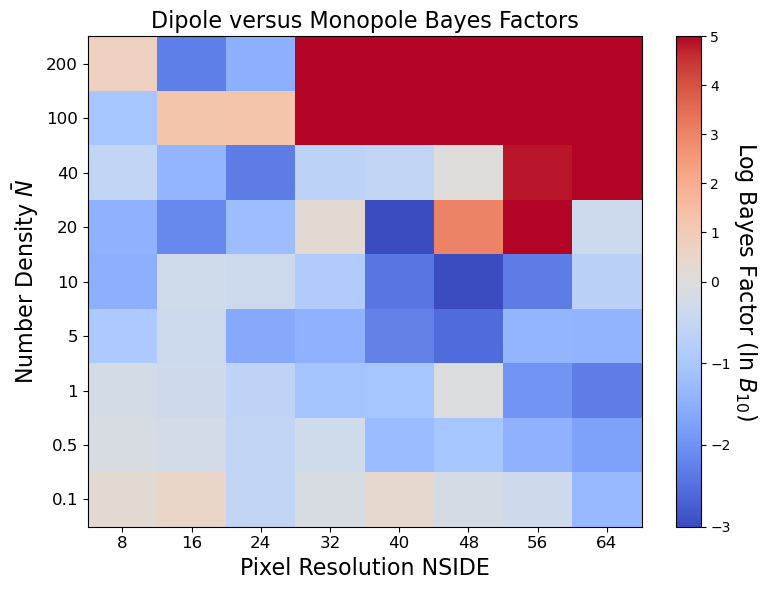

In [69]:
matrix_plotting(Bayes_factors, N_bars, resolutions)

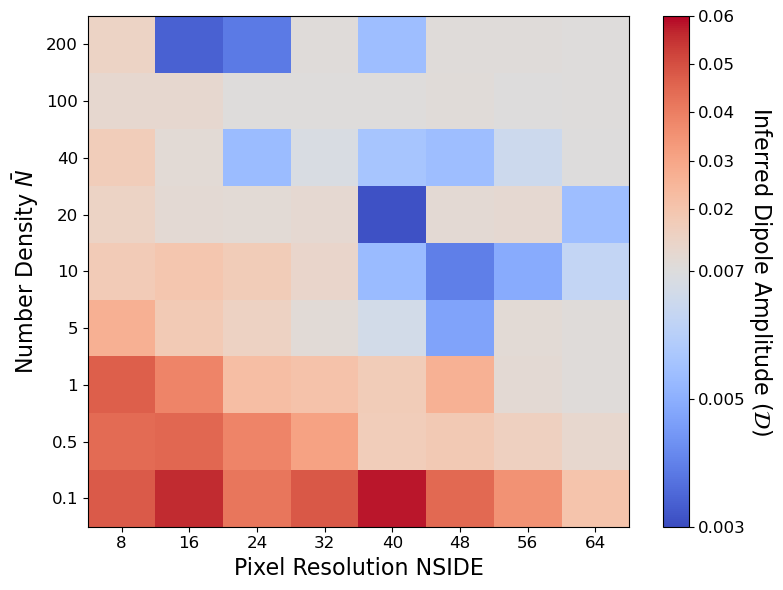

In [72]:
# matrix_plotting(dipole_amplitudes, N_bars, resolutions)
x_vals = []
y_vals = []
weights = []

c=1
for N_bar, values in dipole_amplitudes.items():
    for i, resolution in enumerate(resolutions):
        y_vals.append(c)
        x_vals.append(i)
        weights.append(float(values[i]))
    c+=1

x_vals = np.array(x_vals)
y_vals = np.array(y_vals)
weights = np.array(weights)
vmin = 0.003
vmax = 0.06
norm = mcolors.TwoSlopeNorm(vmin=vmin, vcenter=0.007, vmax=vmax)

x_min, x_max = min(x_vals), max(x_vals)
y_min, y_max = min(y_vals), max(y_vals)

plt.figure(figsize=(8, 6))
plt.hist2d(x_vals, y_vals, bins=[np.arange(x_min, x_max + 2, 1), np.arange(y_min, y_max + 2, 1)],
           weights=weights, cmap='coolwarm', norm=norm)

cbar = plt.colorbar()
cbar.set_label(r'Inferred Dipole Amplitude ($\mathcal{D}$)', rotation=270, labelpad=+20, fontsize=16)
ticks = [0.003, 0.005, 0.007, 0.02, 0.03, 0.04, 0.05, 0.06]
cbar.set_ticks(ticks)
cbar.set_ticklabels([str(t) for t in ticks], fontsize=12)

plt.xlabel('Pixel Resolution NSIDE', fontsize=16)
plt.ylabel(r'Number Density $\bar N$', fontsize=16)
# plt.title('Estimated Dipole Amplitude')
plt.xticks(np.arange(x_min + 0.5, x_max + 1, 1), resolutions, fontsize=12)  
plt.yticks(np.arange(y_min + 0.5, y_max + 1, 1), N_bars, fontsize=12)  

plt.tight_layout()
plt.savefig('../Figures/dipole_amplitude_comparison_matrix_large.png',dpi=300)
plt.show()

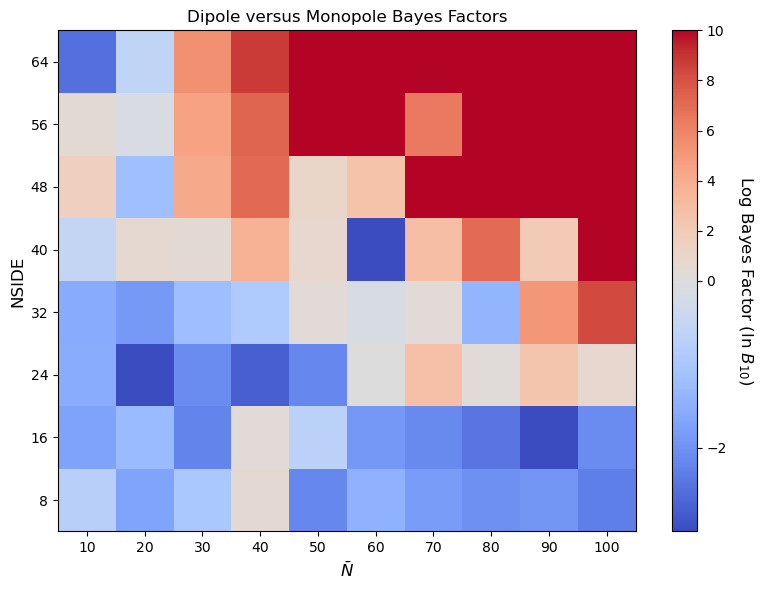

In [93]:
# with open("Bayes_factors.json", "r") as f:
#     loaded_Bayes_factors = json.load(f)
# Bayes_factors = loaded_Bayes_factors

# resolutions = [8,16,24,32,40,48,56,64]
# N_bars = [10,20,30,40,50,60,70,80,90,100]

# x_vals = []
# y_vals = []
# weights = []

# c=1
# for N_bar, values in Bayes_factors.items():
#     for i, resolution in enumerate(resolutions):
#         x_vals.append(c)
#         y_vals.append(i)
#         weights.append(float(values[i]))
#     c+=1
    
# x_vals = np.array(x_vals)
# y_vals = np.array(y_vals)
# weights = np.array(weights)
# norm = mcolors.TwoSlopeNorm(vmin=-3, vcenter=0, vmax=10)

# x_min, x_max = min(x_vals), max(x_vals)
# y_min, y_max = min(y_vals), max(y_vals)

# plt.figure(figsize=(8, 6))
# plt.hist2d(x_vals, y_vals, bins=[np.arange(x_min, x_max + 2, 1), np.arange(y_min, y_max + 2, 1)], weights=weights, cmap='coolwarm', norm=norm)
# cbar = plt.colorbar()
# cbar.set_label(r'Log Bayes Factor (ln $B_{10}$)', rotation=270, labelpad=+20, fontsize=12)

# plt.xlabel(r'$\bar N$', fontsize=12)
# plt.ylabel('NSIDE', fontsize=12)
# plt.title('Dipole versus Monopole Bayes Factors')
# plt.xticks(np.arange(x_min + 0.5, x_max + 1, 1), N_bars)  
# plt.yticks(np.arange(y_min + 0.5, y_max + 1, 1), resolutions)  
# plt.tight_layout()
# # plt.savefig('../Figures/bayes_factor_comparison_matrix.png',dpi=300)
# plt.show()

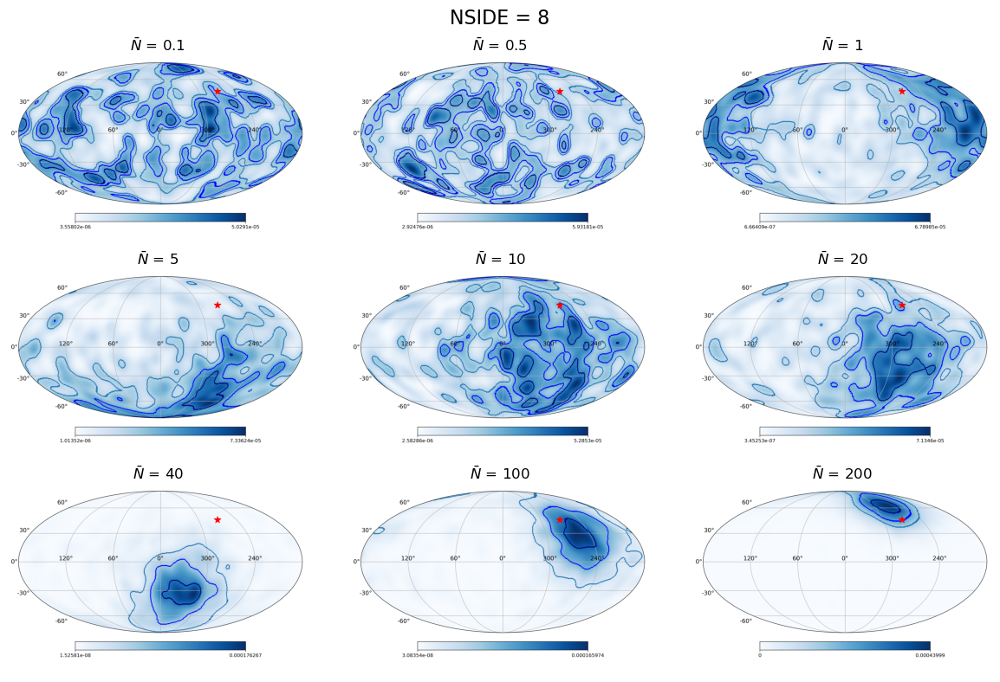

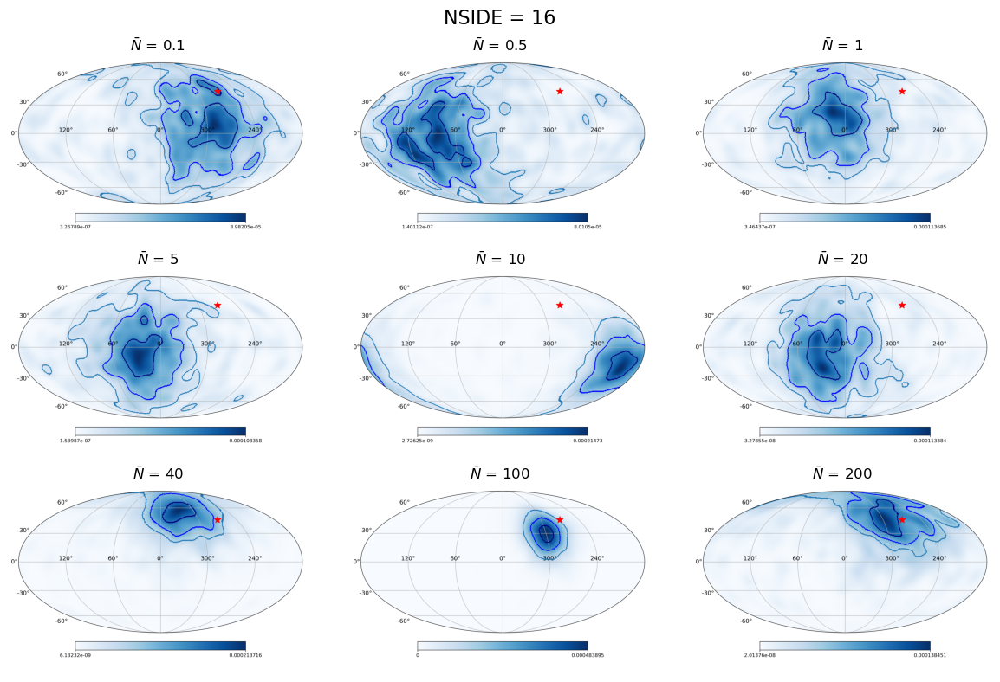

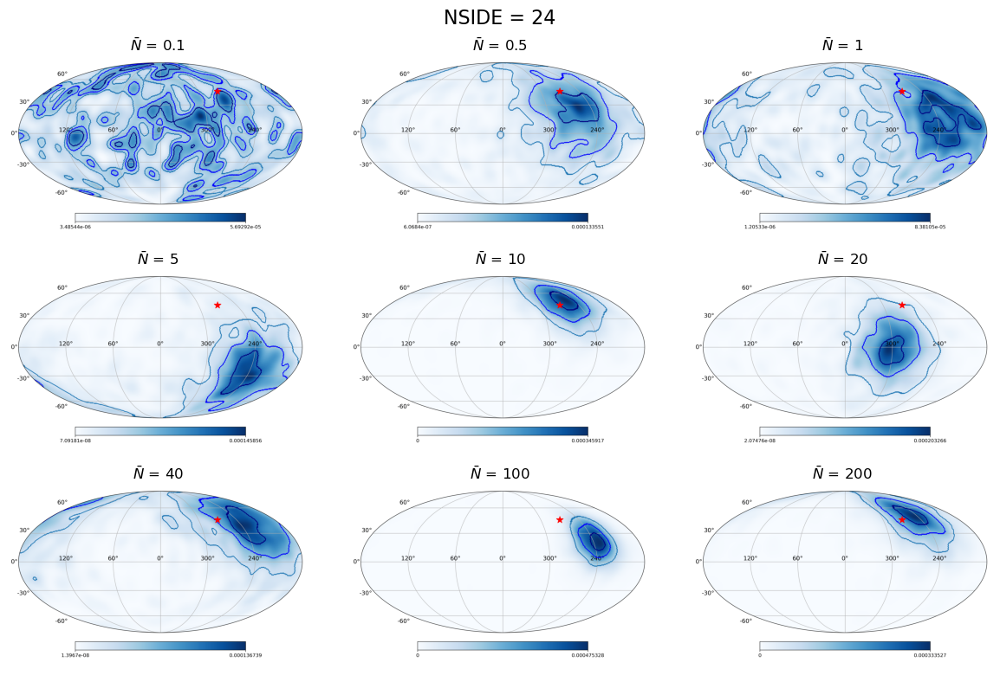

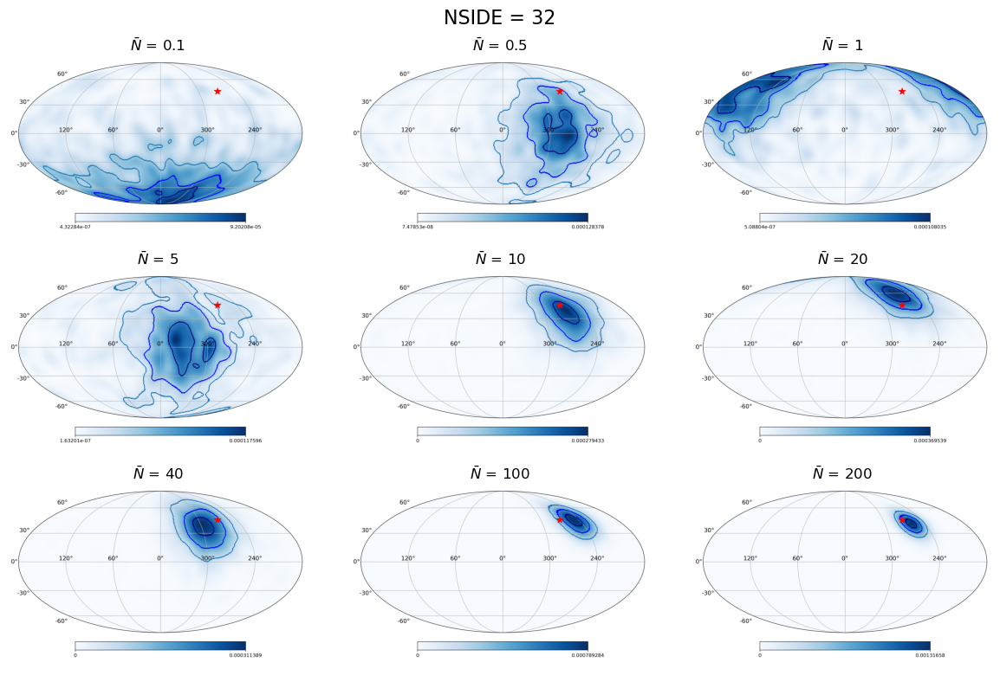

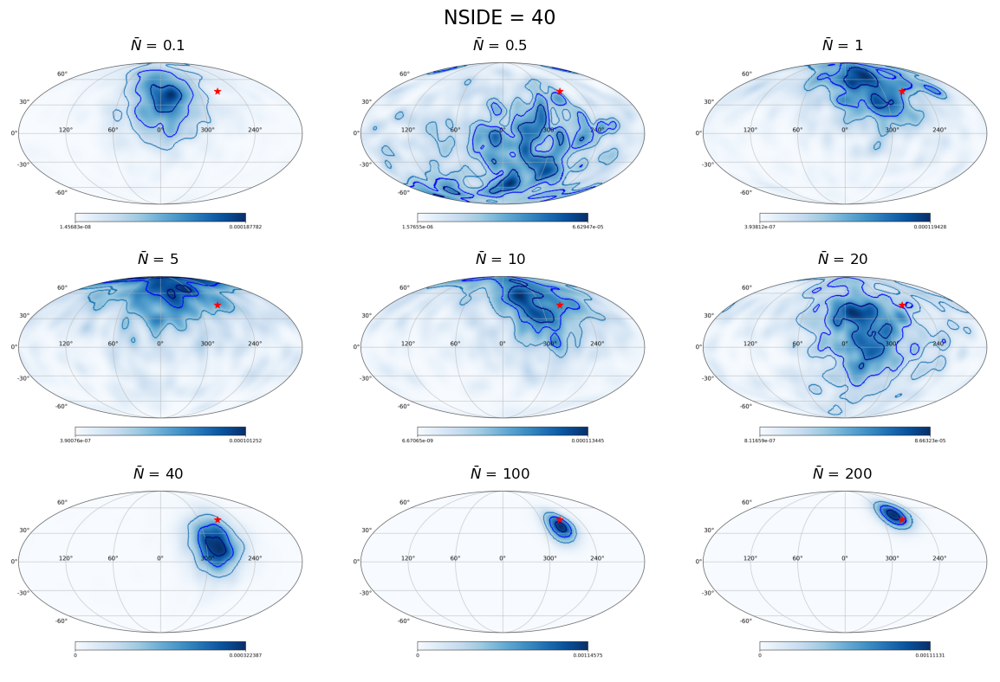

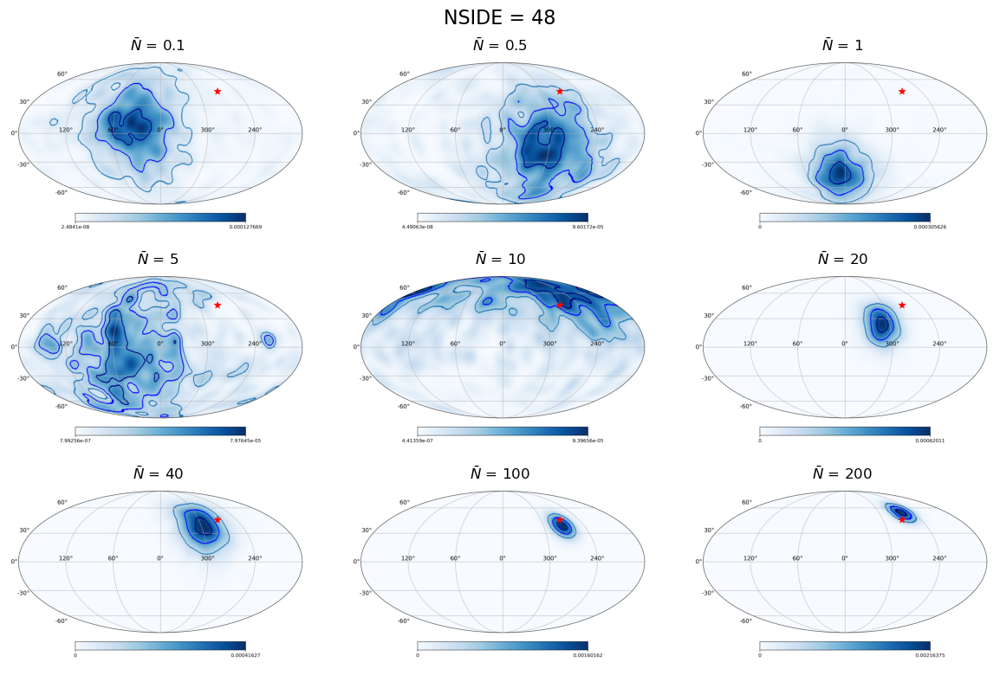

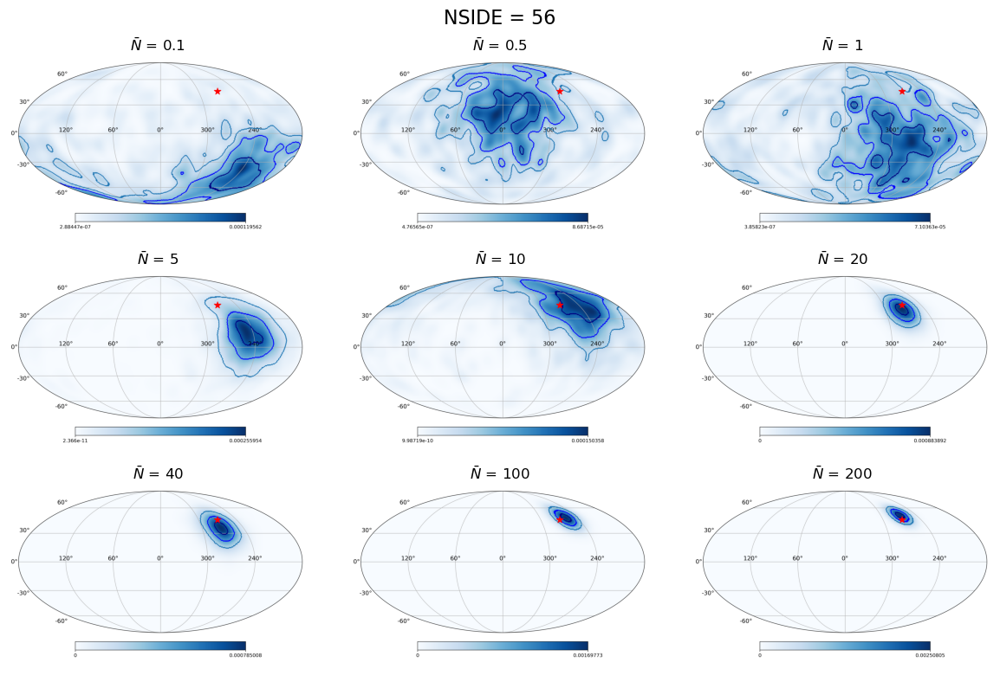

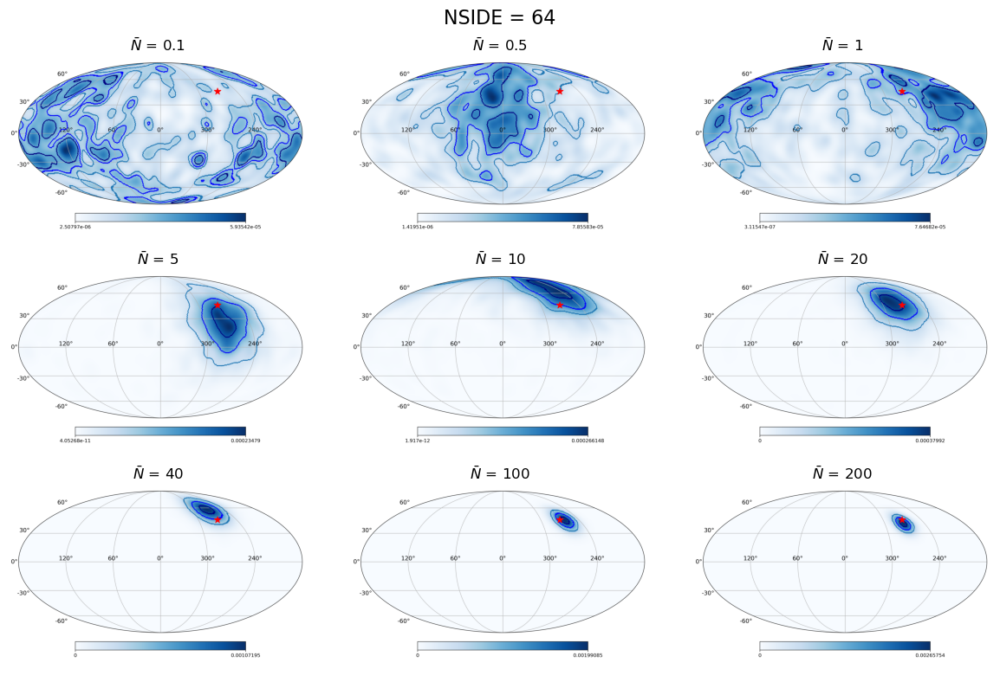

In [16]:
folder_path = '../Figures/Loop/Dipole_distributions/'


s_values = ["0.1", "0.5", "1", "5", "10", "20", "40", "100", "200"]

n_values = [8, 16, 24, 32, 40, 48, 56, 64]

for n_value in n_values:
    image_files = [f'nside_{n_value}_nbar_{s}_dipole.png' for s in s_values]
    
    missing_files = [f for f in image_files if not os.path.exists(os.path.join(folder_path, f))]
    if missing_files:
        print(f'Warning: Missing images for NSIDE={n_value}: {missing_files}')
        continue
    
    
    fig, axes = plt.subplots(3, 3, figsize=(12, 8))
    fig.suptitle(f'NSIDE = {n_value}', fontsize=16) 
    
    
    for ax, img_file, s_value in zip(axes.flat, image_files, s_values):
        img = mpimg.imread(os.path.join(folder_path, img_file))
        ax.imshow(img)
        ax.axis('off') 
        ax.set_title(r'$\bar{N}$ =' + f' {s_value}')
    
    plt.tight_layout()
    plt.savefig(folder_path+f'/Combined/NSIDE_{str(n_value)}_distributions.png', dpi=300)
    plt.show()
    plt.close()

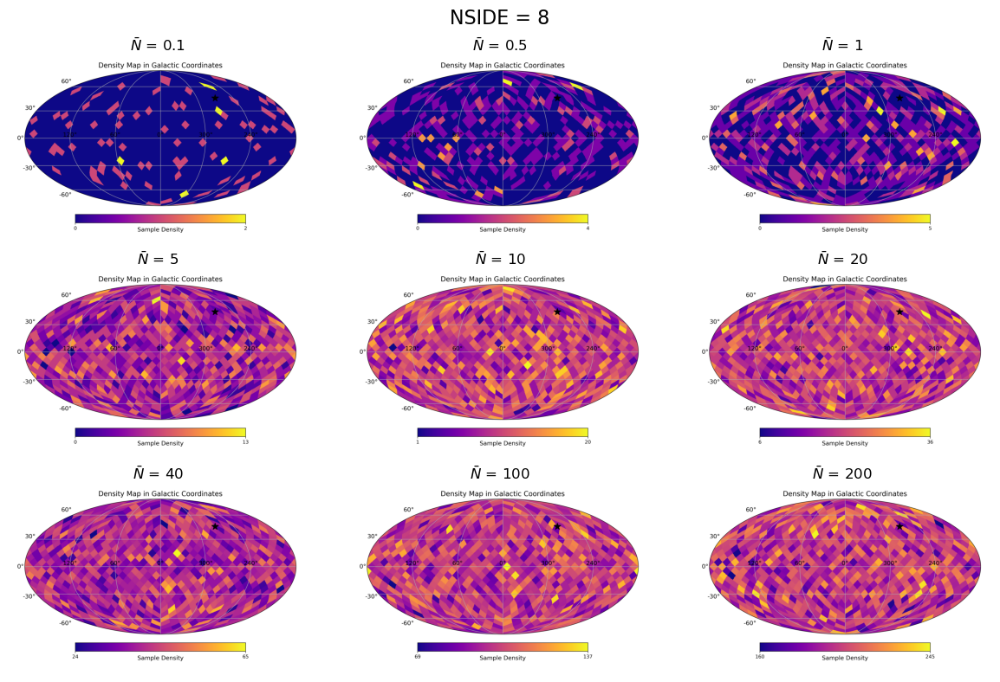

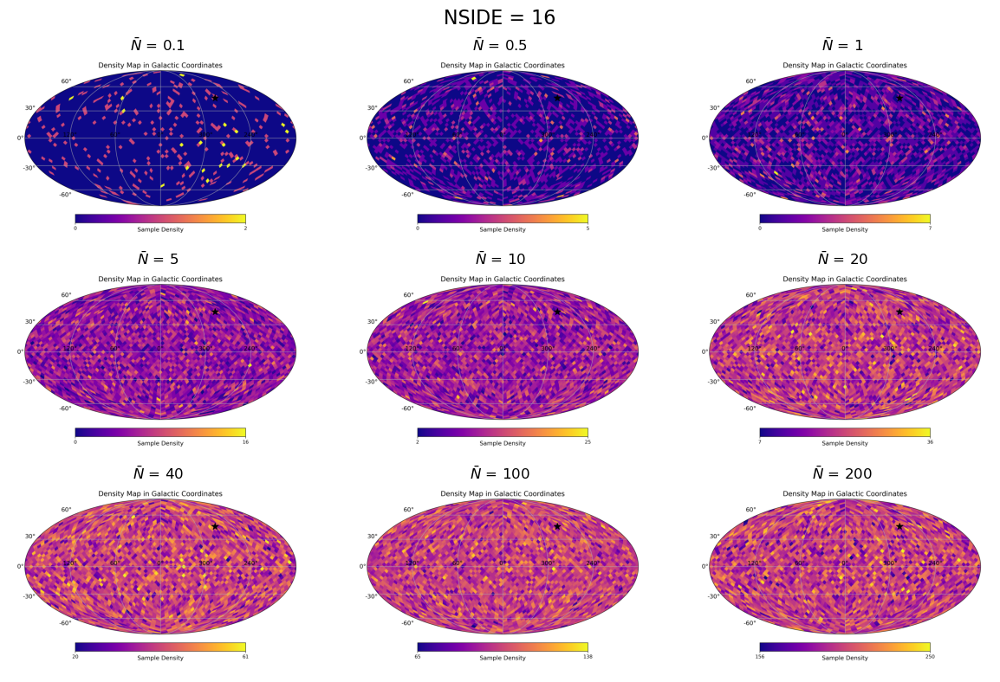

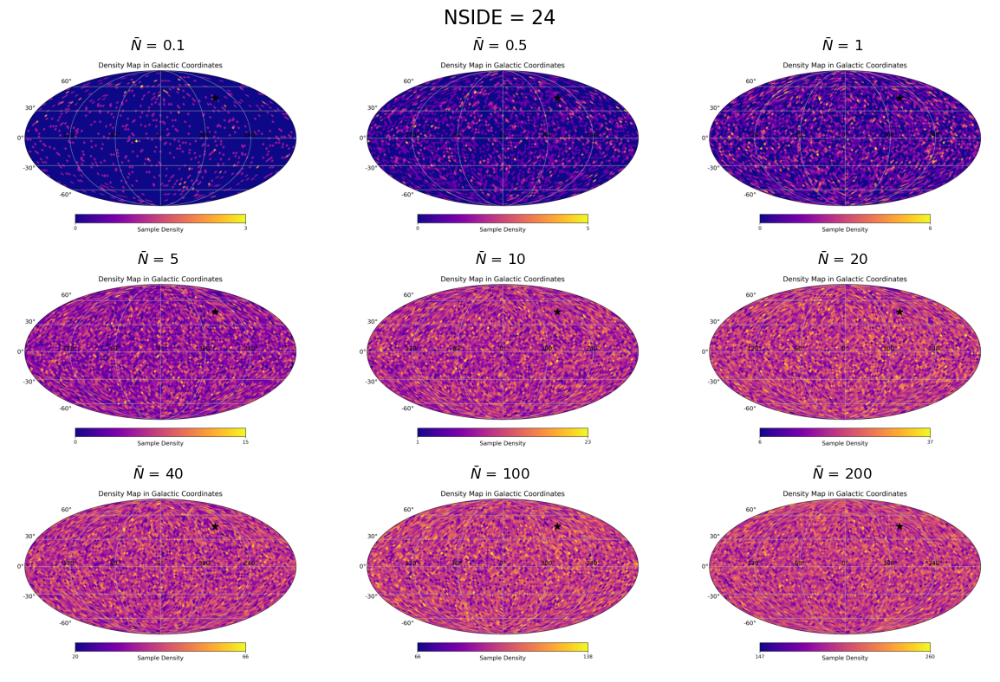

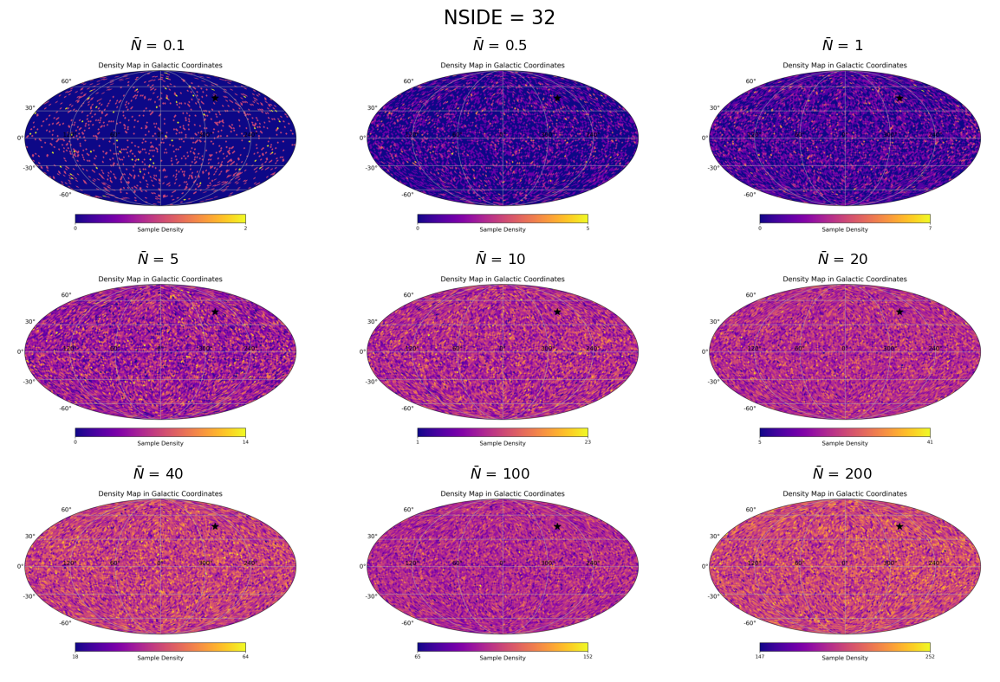

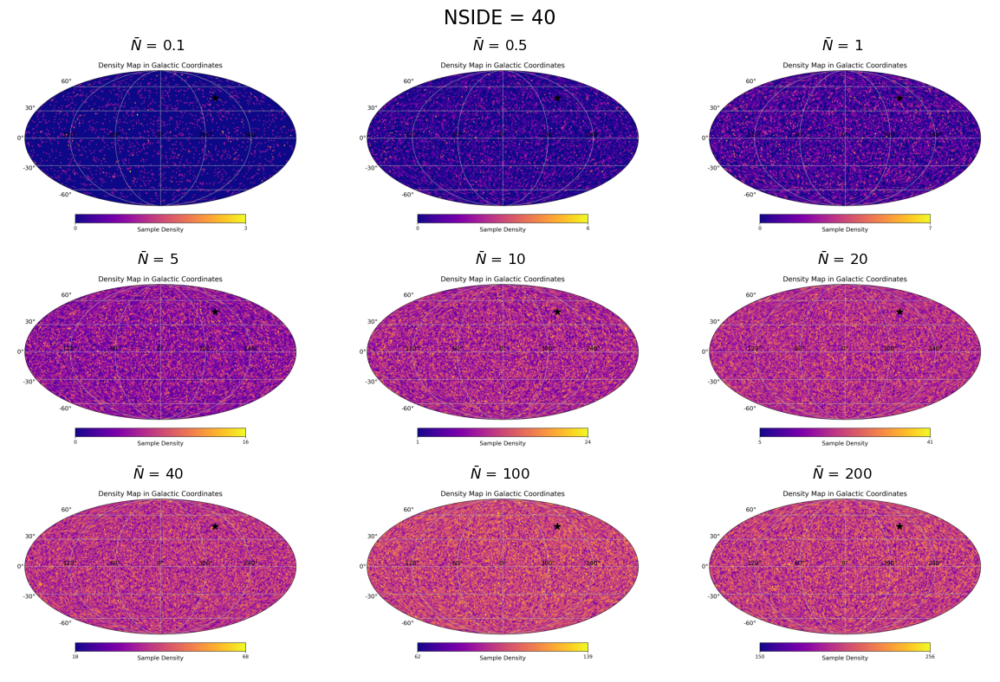

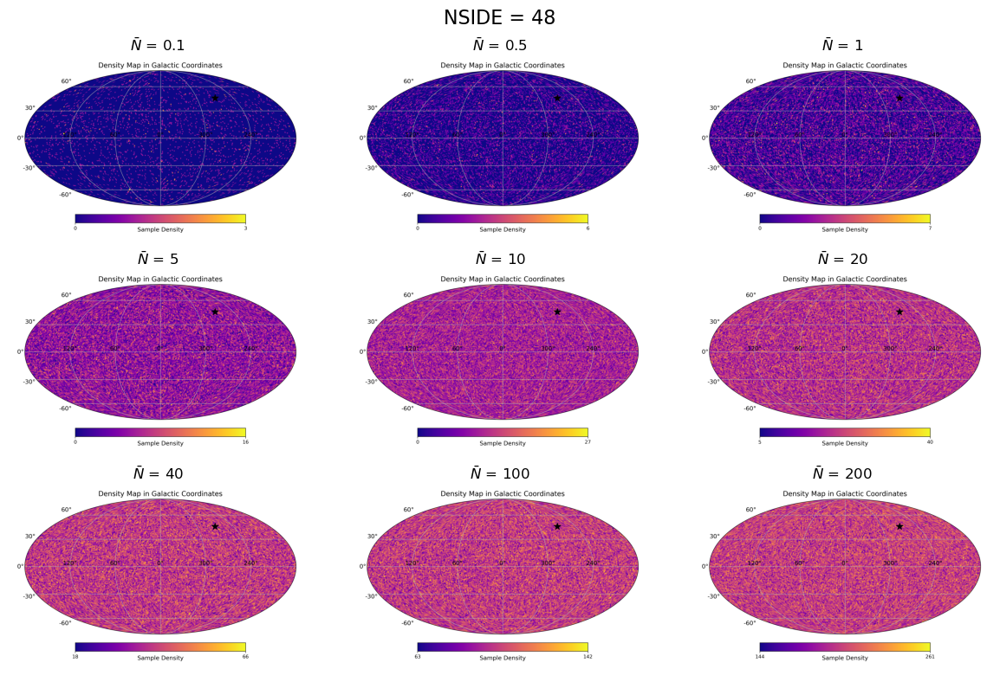

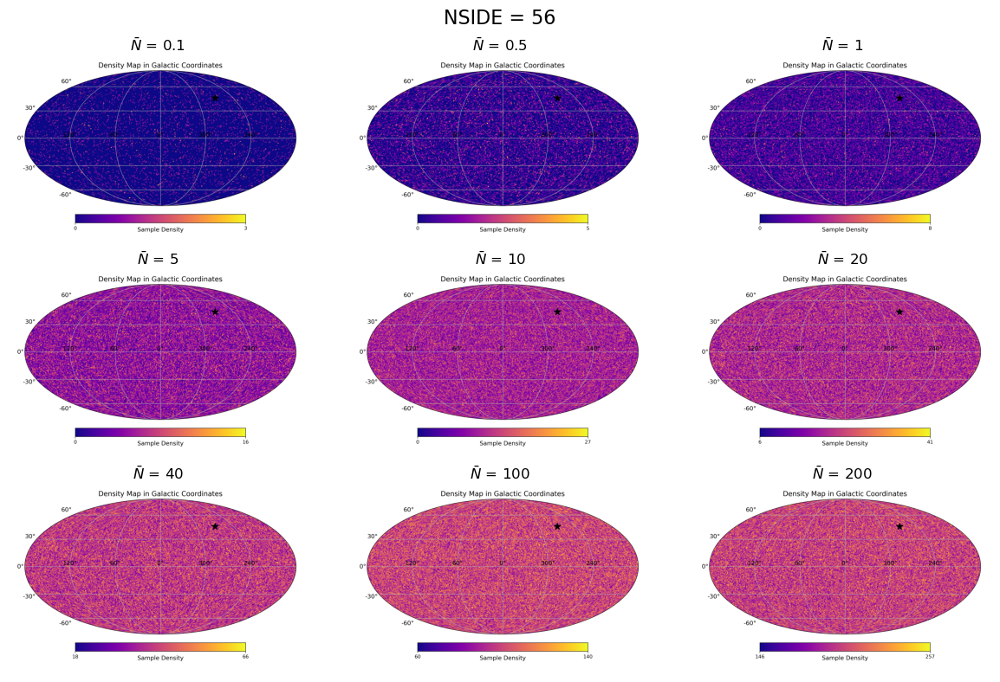

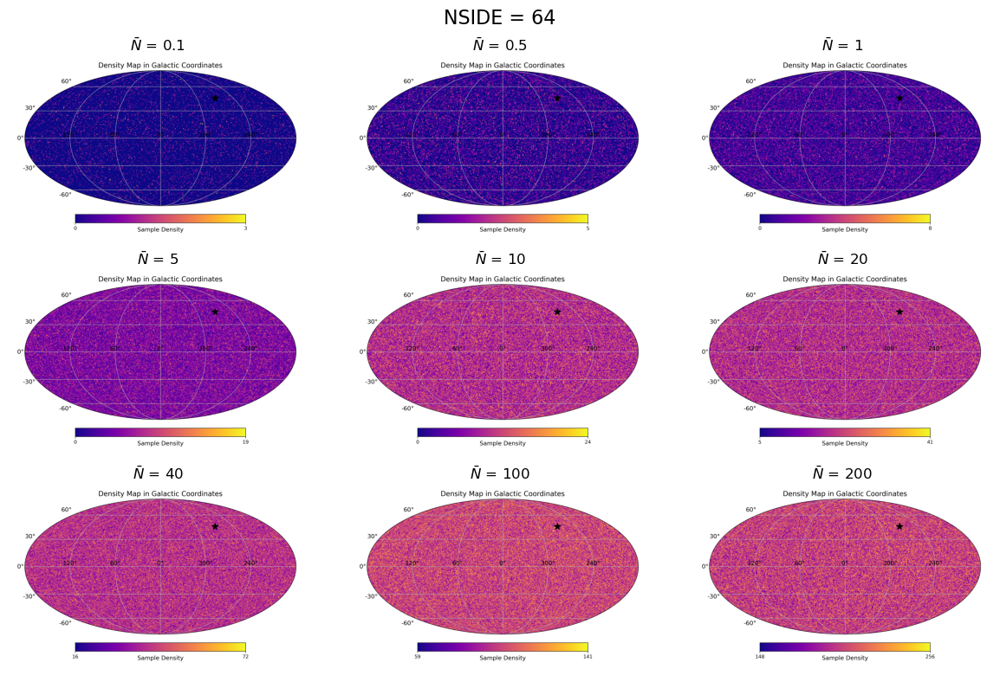

In [17]:
folder_path = '../Figures/Loop/Skymaps/'


s_values = ["0.1", "0.5", "1", "5", "10", "20", "40", "100", "200"]

n_values = [8, 16, 24, 32, 40, 48, 56, 64]

for n_value in n_values:
    image_files = [f'nside_{n_value}_nbar_{s}_skymap.png' for s in s_values]
    
    missing_files = [f for f in image_files if not os.path.exists(os.path.join(folder_path, f))]
    if missing_files:
        print(f'Warning: Missing images for NSIDE={n_value}: {missing_files}')
        continue
    
    
    fig, axes = plt.subplots(3, 3, figsize=(12, 8))
    fig.suptitle(f'NSIDE = {n_value}', fontsize=16) 
    
    
    for ax, img_file, s_value in zip(axes.flat, image_files, s_values):
        img = mpimg.imread(os.path.join(folder_path, img_file))
        ax.imshow(img)
        ax.axis('off') 
        ax.set_title(r'$\bar{N}$ =' + f' {s_value}')
    
    plt.tight_layout()
    plt.savefig(folder_path+f'/Combined/NSIDE_{str(n_value)}_skymaps.png', dpi=300)
    plt.show()
    plt.close()

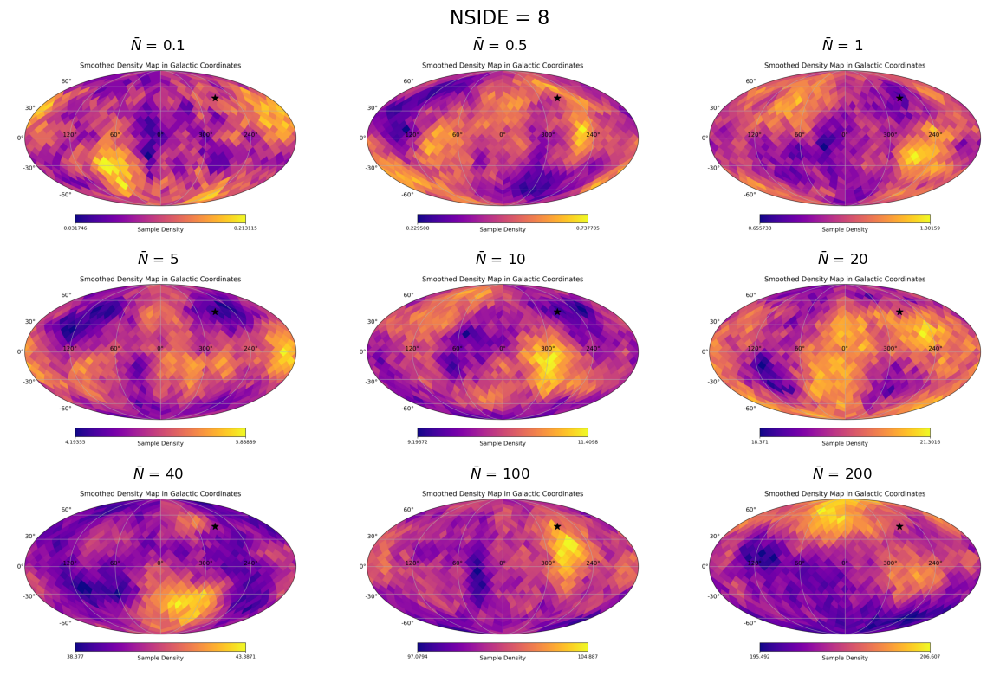

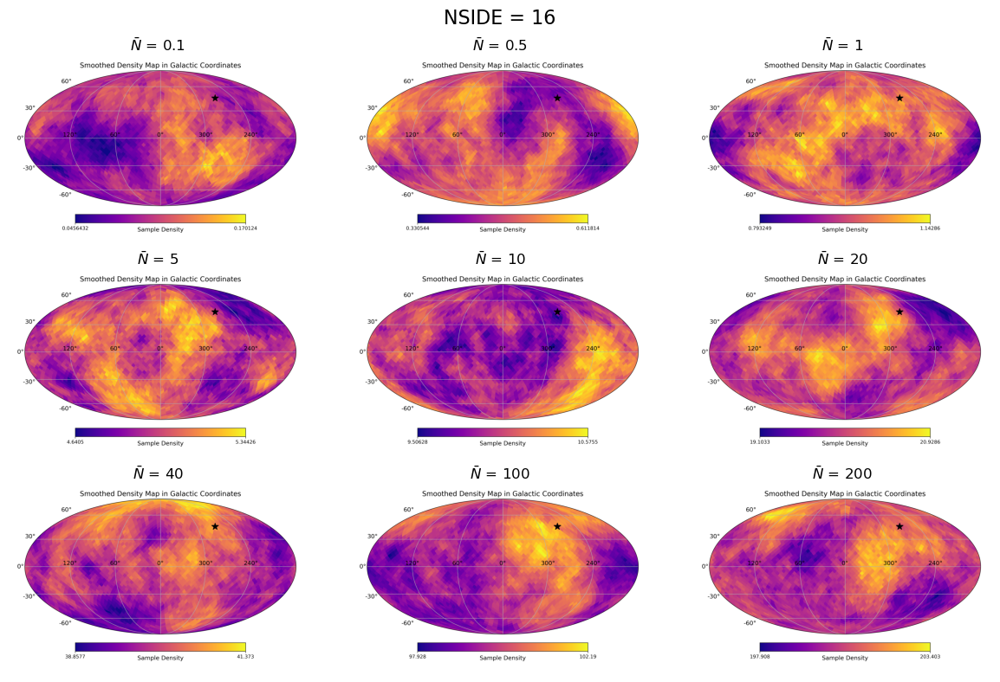

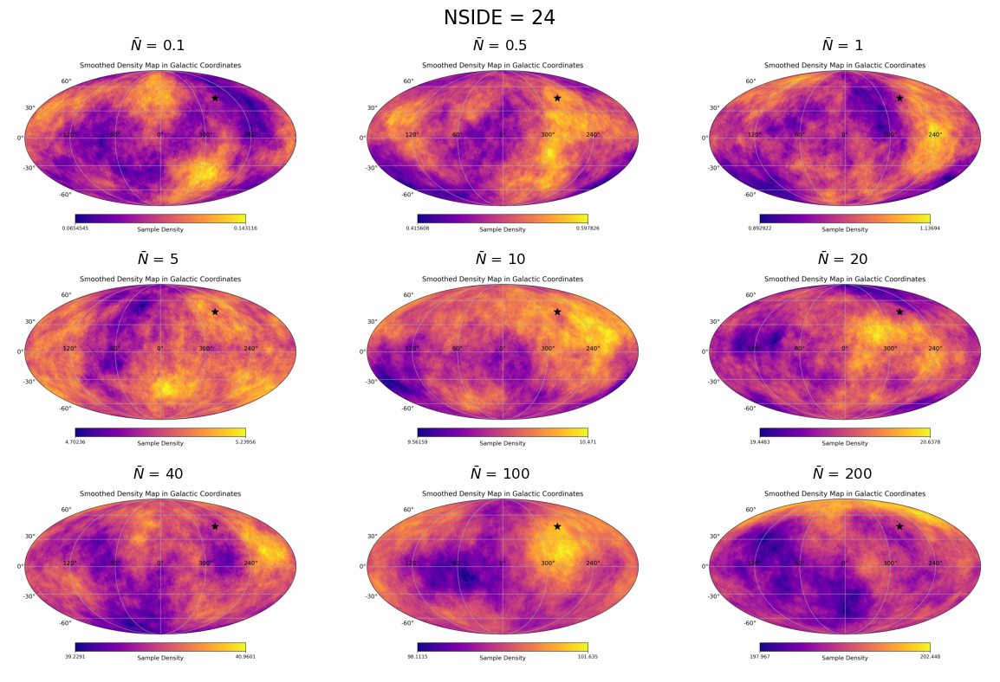

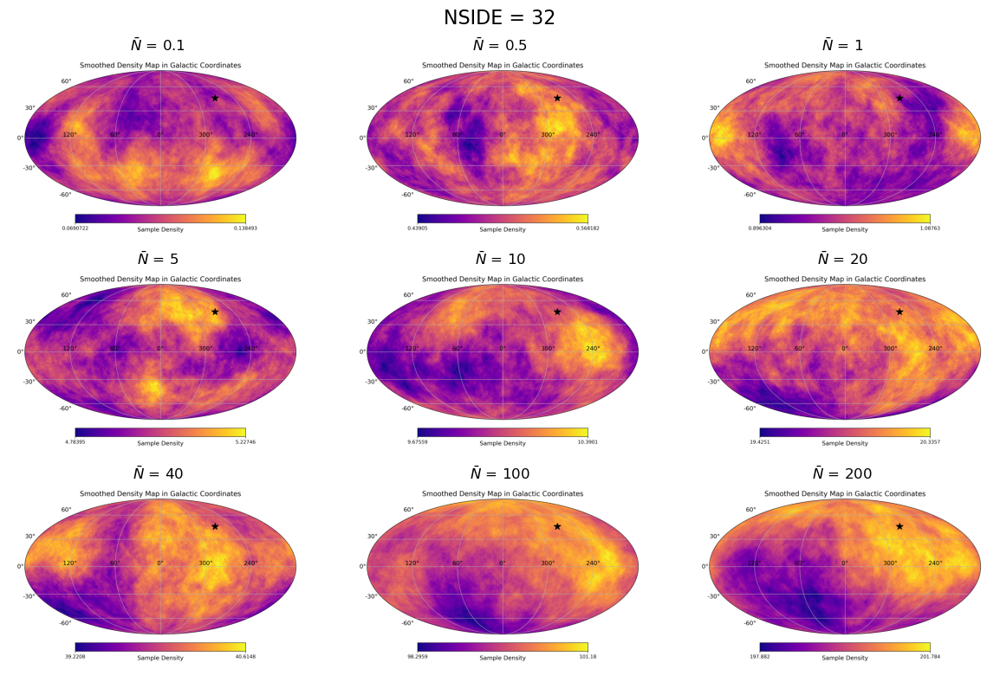

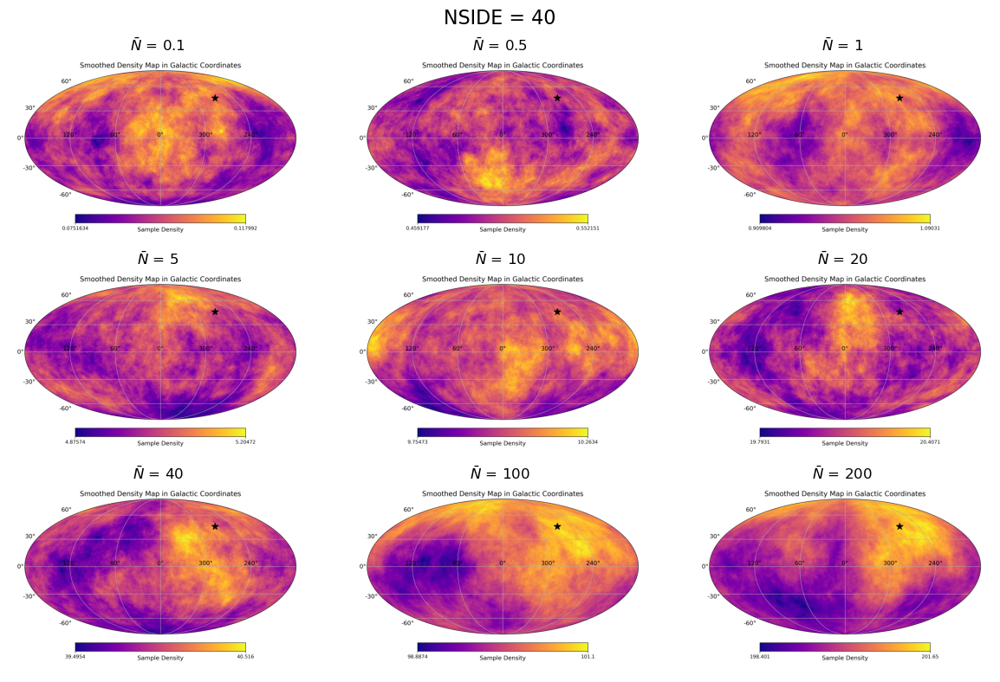

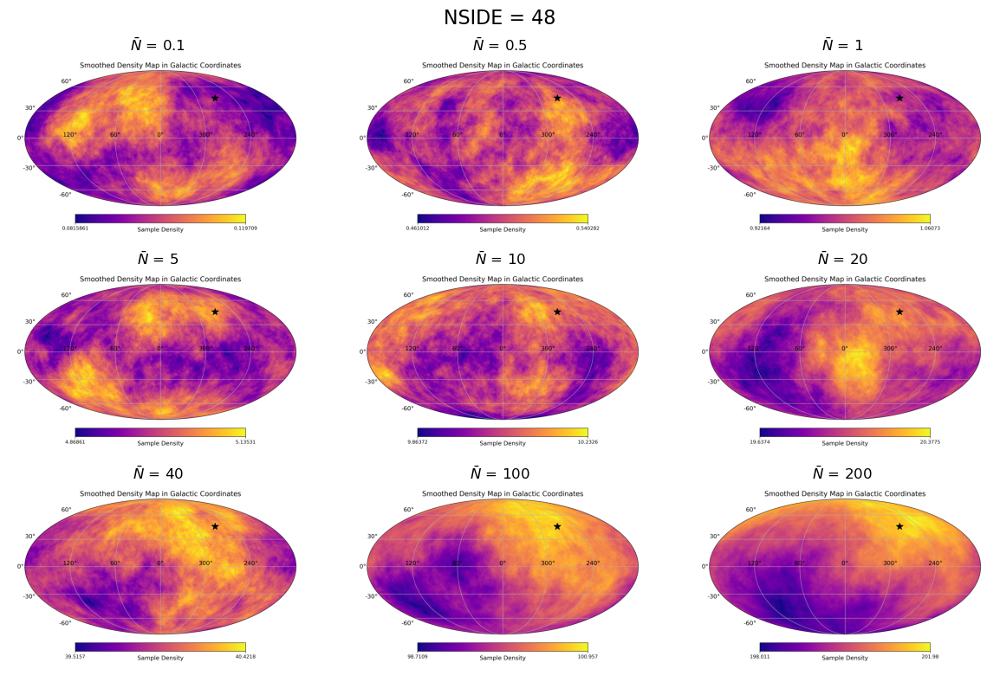

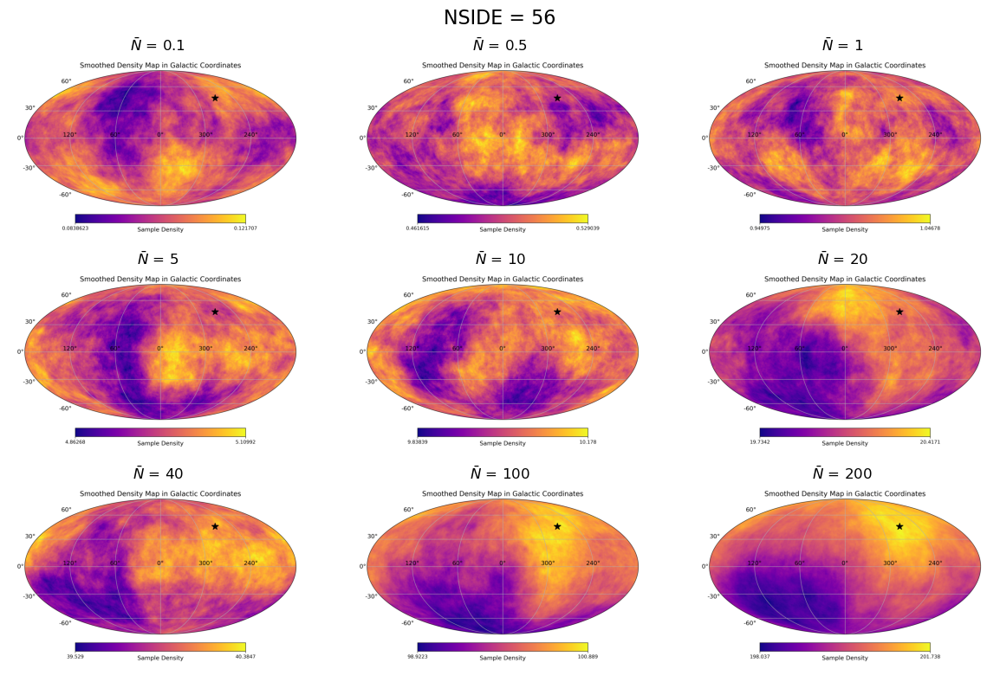

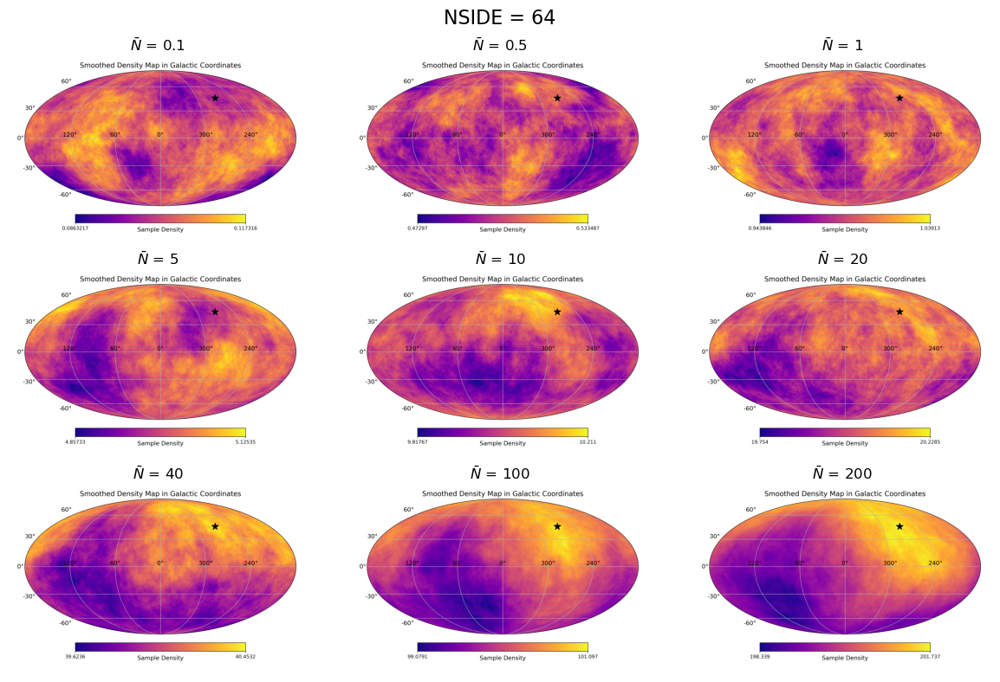

In [18]:
folder_path = '../Figures/Loop/Smoothed_skymaps/'


s_values = ["0.1", "0.5", "1", "5", "10", "20", "40", "100", "200"]

n_values = [8, 16, 24, 32, 40, 48, 56, 64]

for n_value in n_values:
    image_files = [f'nside_{n_value}_nbar_{s}_smoothed_skymap.png' for s in s_values]
    
    missing_files = [f for f in image_files if not os.path.exists(os.path.join(folder_path, f))]
    if missing_files:
        print(f'Warning: Missing images for NSIDE={n_value}: {missing_files}')
        continue
    
    
    fig, axes = plt.subplots(3, 3, figsize=(12, 8))
    fig.suptitle(f'NSIDE = {n_value}', fontsize=16) 
    
    
    for ax, img_file, s_value in zip(axes.flat, image_files, s_values):
        img = mpimg.imread(os.path.join(folder_path, img_file))
        ax.imshow(img)
        ax.axis('off') 
        ax.set_title(r'$\bar{N}$ =' + f' {s_value}')
    
    plt.tight_layout()
    plt.savefig(folder_path+f'/Combined/NSIDE_{str(n_value)}_smoothed_skymaps.png', dpi=300)
    plt.show()
    plt.close()

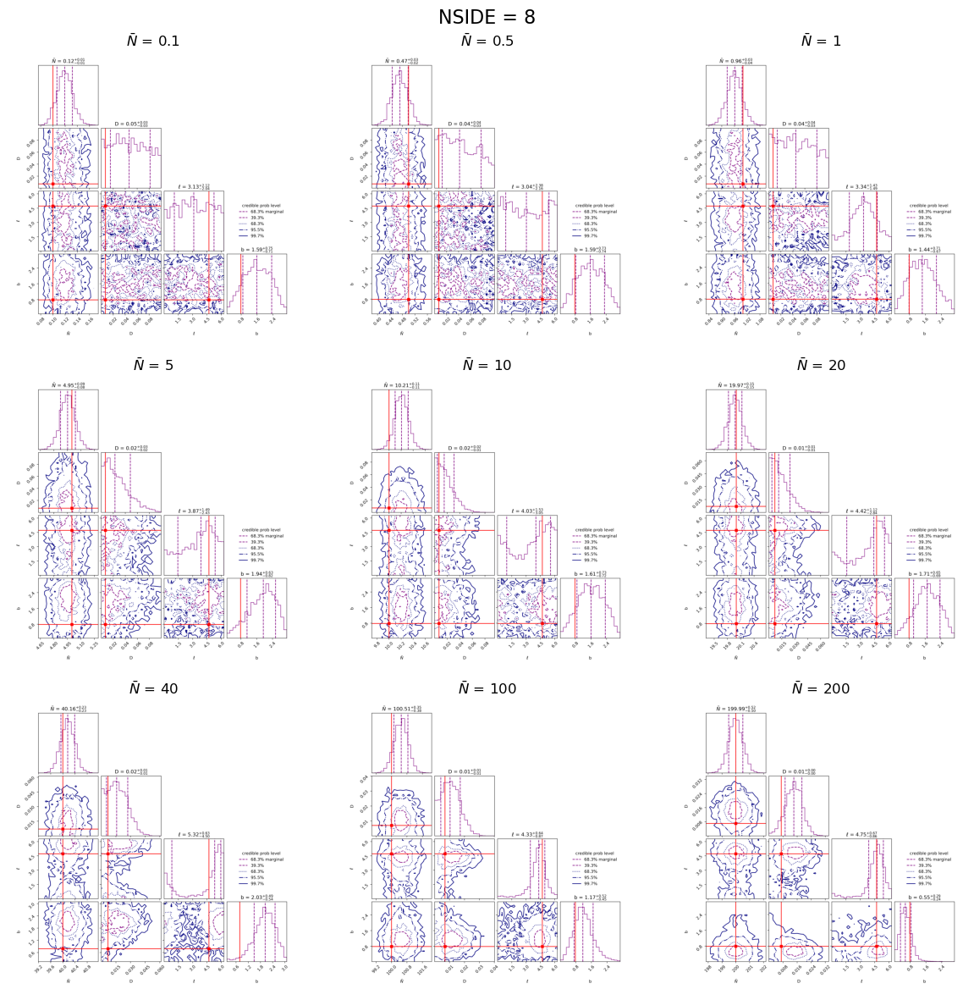

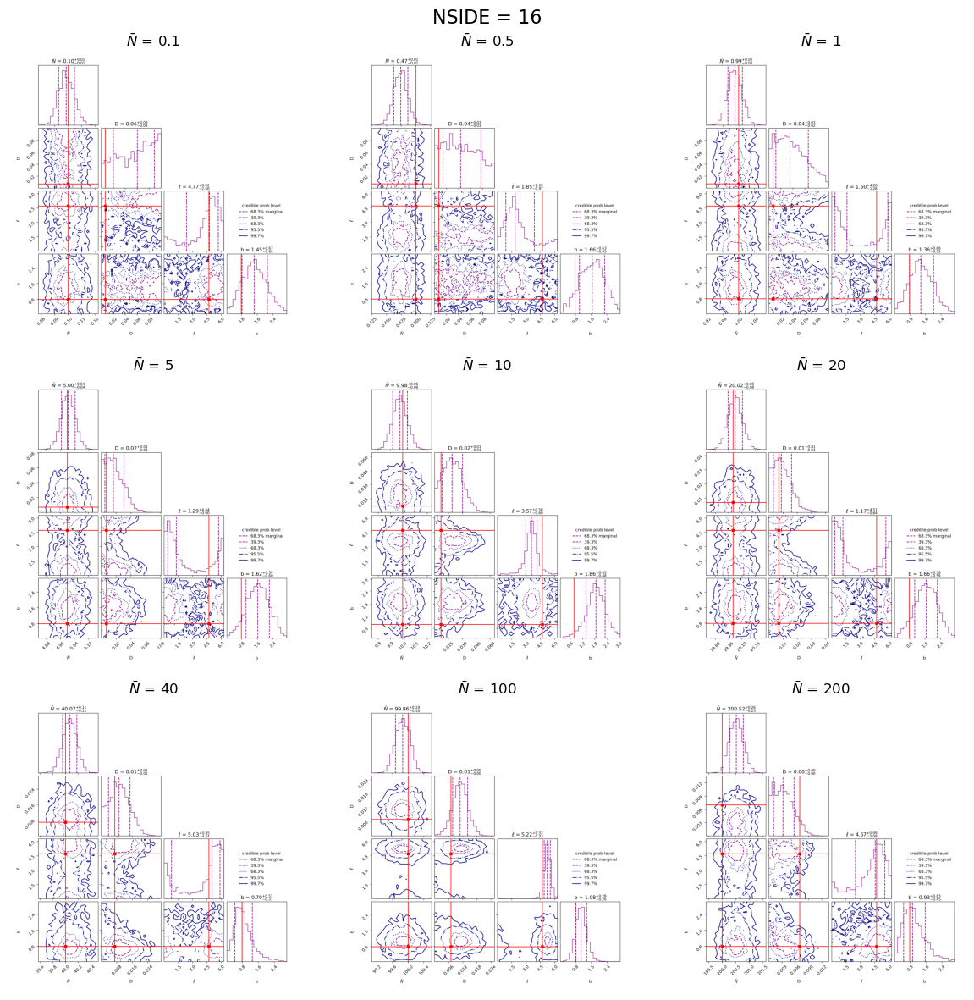

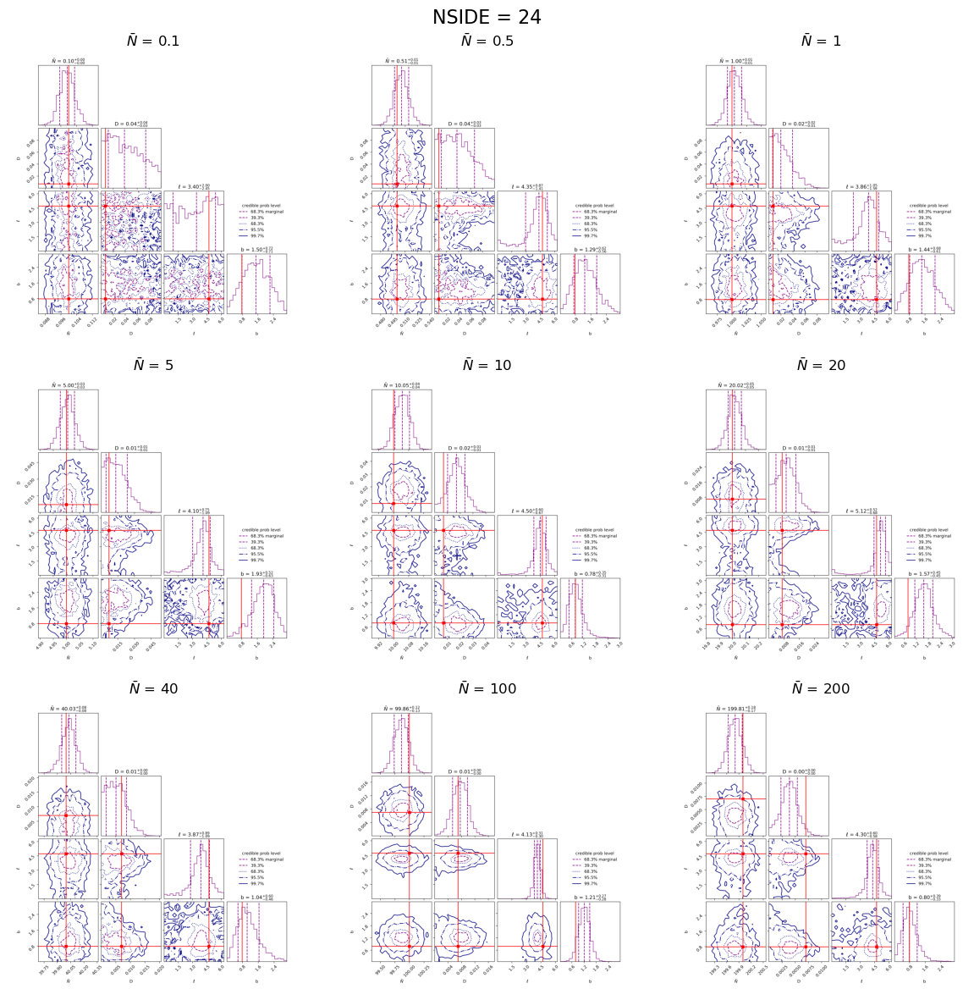

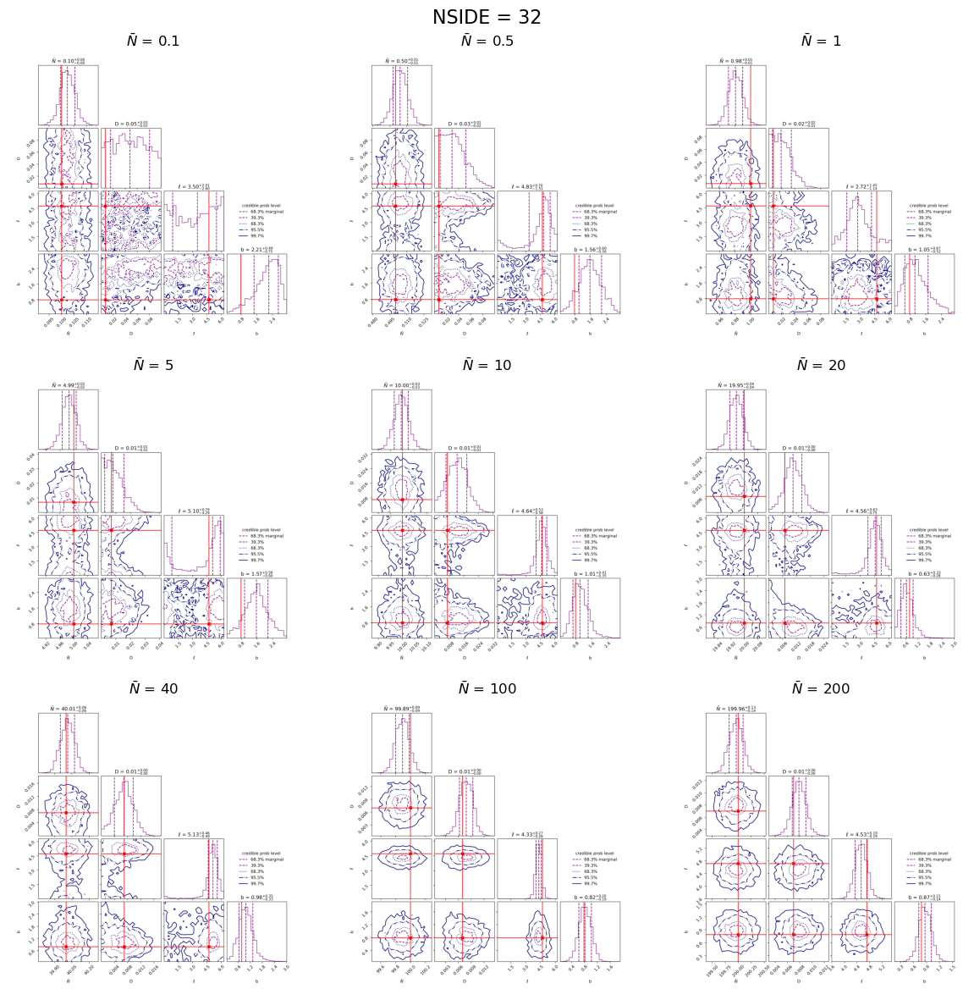

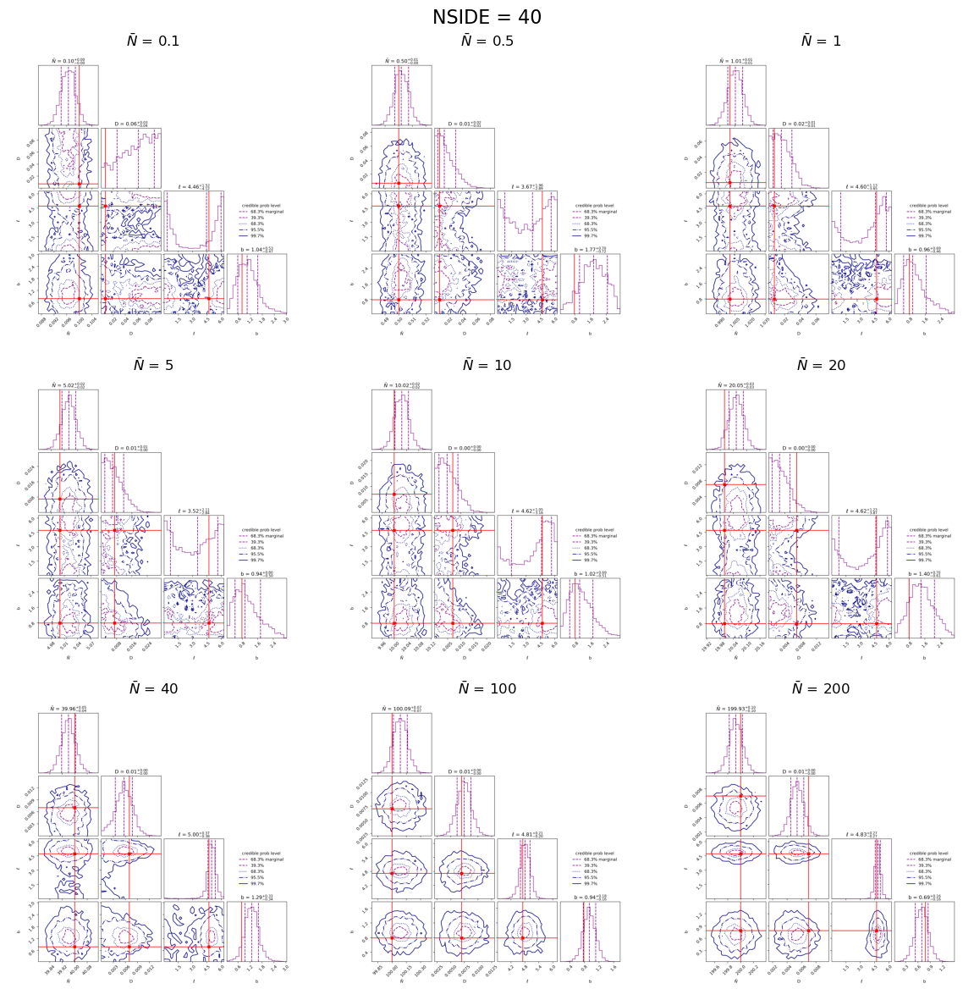

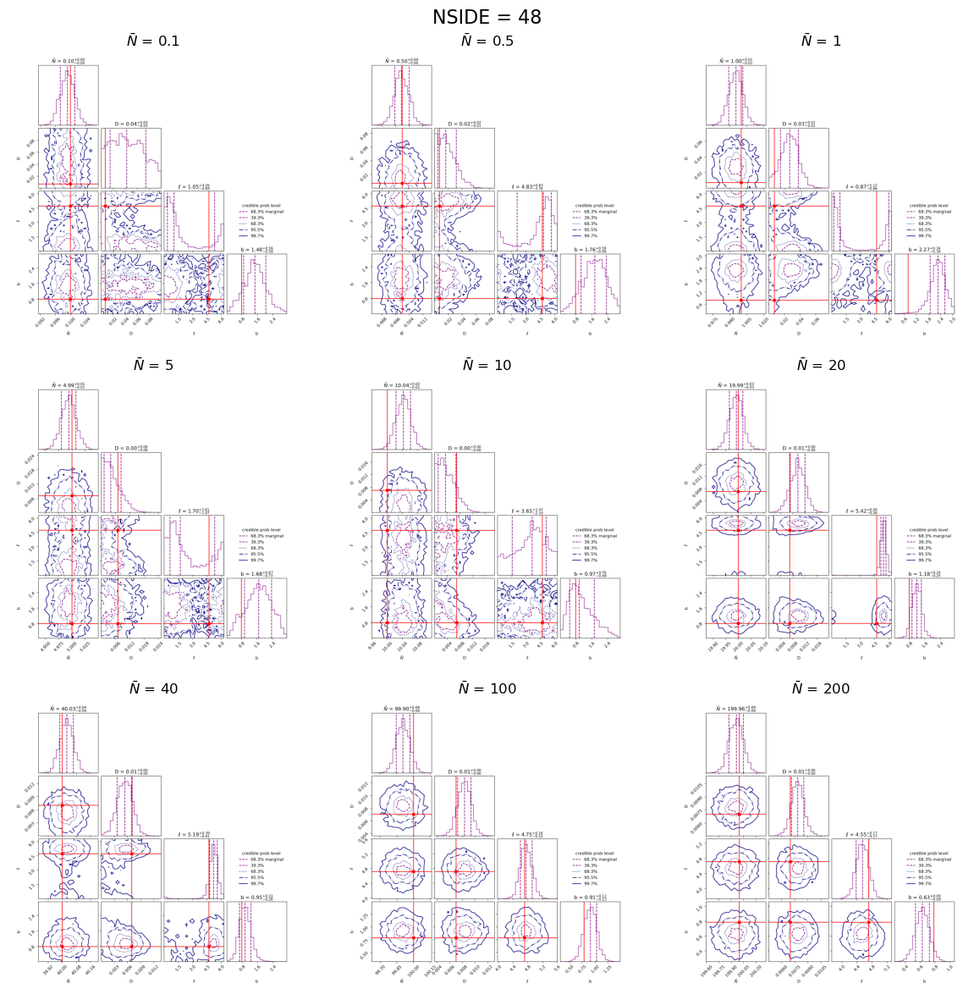

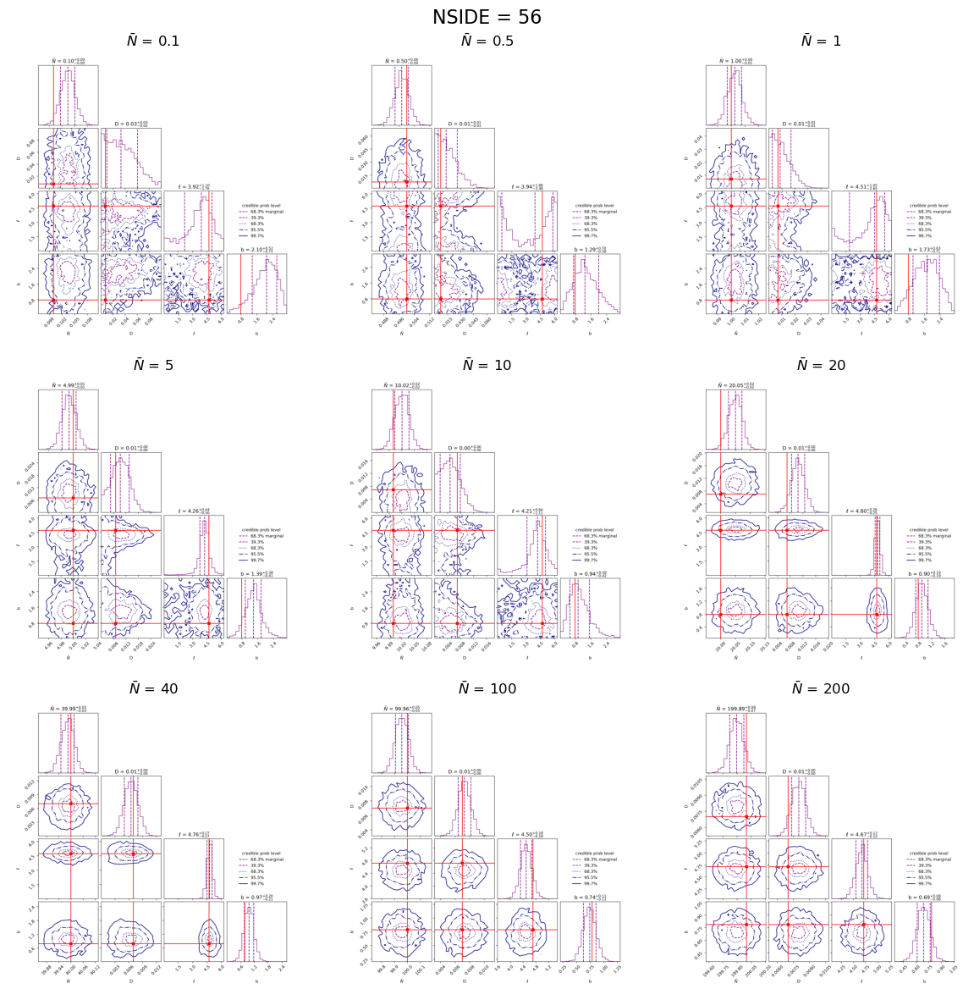

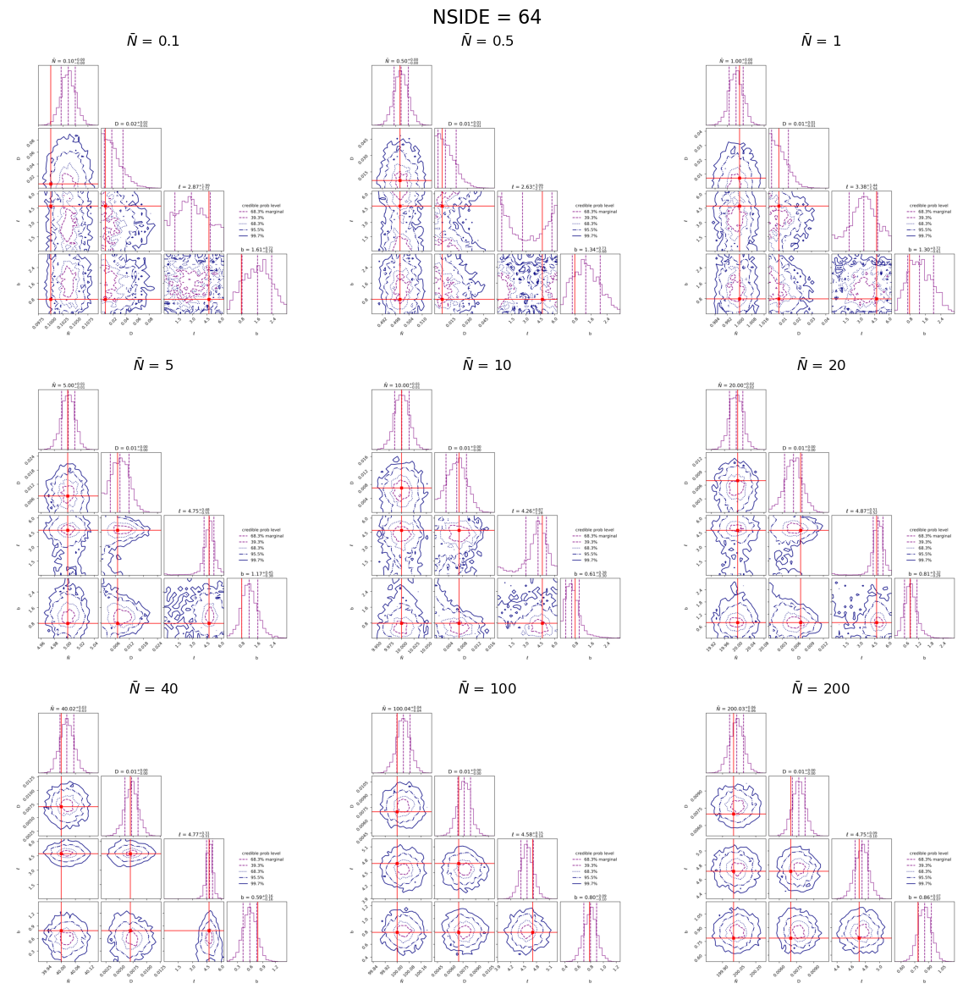

In [8]:
folder_path = '../Figures/Loop/Cornerplots/Dipole/'


s_values = ["0.1", "0.5", "1", "5", "10", "20", "40", "100", "200"]

n_values = [8, 16, 24, 32, 40, 48, 56, 64]

for n_value in n_values:
    image_files = [f'nside_{n_value}_nbar_{s}_CP_D.png' for s in s_values]
    
    missing_files = [f for f in image_files if not os.path.exists(os.path.join(folder_path, f))]
    if missing_files:
        print(f'Warning: Missing images for NSIDE={n_value}: {missing_files}')
        continue
    
    
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))
    fig.suptitle(f'NSIDE = {n_value}', fontsize=16) 
    
    
    for ax, img_file, s_value in zip(axes.flat, image_files, s_values):
        img = mpimg.imread(os.path.join(folder_path, img_file))
        ax.imshow(img)
        ax.axis('off') 
        ax.set_title(r'$\bar{N}$ =' + f' {s_value}')
    
    plt.tight_layout()
    plt.savefig(folder_path+f'/Combined/NSIDE_{str(n_value)}_CP_D.png', dpi=300)
    plt.show()
    plt.close()